In [1]:
# _____ ______  _____         ___   _   _   ___   _   __   _______ _____ _____        _    _ _____ 
#|  __ \| ___ \|  _  |       / _ \ | \ | | / _ \ | |  \ \ / /  ___|_   _/  ___|      | |  | |_   _|
#| |  \/| |_/ /| | | |______/ /_\ \|  \| |/ /_\ \| |   \ V /\ `--.  | | \ `--. ______| |  | | | |  
#| | __ | ___ \| | | |______|  _  || . ` ||  _  || |    \ /  `--. \ | |  `--. \______| |/\| | | |  
#| |_\ \| |_/ /\ \_/ /      | | | || |\  || | | || |____| | /\__/ /_| |_/\__/ /      \  /\  / | |  
# \____/\____/  \___/       \_| |_/\_| \_/\_| |_/\_____/\_/ \____/ \___/\____/        \/  \/  \_/  
                                                                                                  
## 20210823 - This is a script that will be used for LIVE data updates/plots at GBO during testing
## We will begin by importing the proper packages from the Drone Modules:
workingdir='/home/tyndall/newburghlab-drone'
from dronehacks.GBO_Corr_Class import *
from dronehacks.Drone_Class import *

In [2]:
## Key, Position, Channel, Polarization, Pointing Variable Assignment:
## RECEIVER INFORMATION is needed to initialize the geometric environments: ##
## Must include some 'key' strings for labelling/identifying receivers: [Pranav's Conventions]
Array_Keys=["Dish_0","Dish_7","Dish_2","Dish_3","Dish_4","Dish_5","Dish_6","Dish_8"]
## Specify Coordinate Origin: #810m about MSL
GBO_HIRAX_DISH_0=pygeodesy.ellipsoidalNvector.LatLon(38.429280, -79.844990, 810).to3llh()
## Must Specify Coordinates and Pointings of receivers in Local Cartesian in an array of shape: n_receivers x 3 ##
Array_Coords=np.array([[0.0, 0.0, 0.0], # "Dish_0" \
                       [-24.215395745765452, -12.605737141316427, 0.0], # "Dish_7" \
                       [-8.403824760877617, 16.143597163843634, 0.0], # "Dish_2" \
                       [-8.071798581921817, -4.2019123804388085, 0.0], # "Dish_3" \
                       [-12.273710962360624, 3.869886201483008, 0.0], # "Dish_4" \
                       [-16.475623342799434, 11.941684783404824, 0.0], # "Dish_5" \
                       [-20.345509544282443, -0.33202617895580033, 0.0], # "Dish_6" \
                       [-28.41730812620426, -4.53393855939461, 0.0]]) # "Dish_8" \
## If pointings are defined by vectors in Local Coordinates (E,N,U) use:
Array_Pointings=np.array([[0,0,1], # +Z (up) in LC \
                          [0,0,1],\
                          [0,0,1],\
                          [0,0,1],\
                          [0,0,1],\
                          [0,0,1],\
                          [0,0,1],\
                          [0,0,1]])
## If pointings are defined by angles from zenith, use:
Array_Pointings=np.array([RotMat(np.array([0.0,0.0,0.0]))@np.array([0.0,0.0,1.0]),  # e.g. 1 deg of yaw and roll \
                          RotMat(np.array([0.0,0.0,0.0]))@np.array([0.0,0.0,1.0]),\
                          RotMat(np.array([0.0,0.0,0.0]))@np.array([0.0,0.0,1.0]),\
                          RotMat(np.array([0.0,0.0,0.0]))@np.array([0.0,0.0,1.0]),\
                          RotMat(np.array([0.0,0.0,0.0]))@np.array([0.0,0.0,1.0]),\
                          RotMat(np.array([0.0,0.0,0.0]))@np.array([0.0,0.0,1.0]),\
                          RotMat(np.array([0.0,0.0,0.0]))@np.array([0.0,0.0,1.0]),\
                          RotMat(np.array([0.0,0.0,0.0]))@np.array([0.0,0.0,1.0])])
## Define Array Polarizations (2 per dish) in Local Cartesian E,N,U:
Array_Pols=np.array([[[1,0,0],[0,1,0]], # E,N \
                     [[1,0,0],[0,1,0]], \
                     [[1,0,0],[0,1,0]], \
                     [[1,0,0],[0,1,0]], \
                     [[1,0,0],[0,1,0]], \
                     [[1,0,0],[0,1,0]], \
                     [[1,0,0],[0,1,0]], \
                     [[1,0,0],[0,1,0]]])

## 8 DISH PLOTTING:
GBO8_chmap=np.array([0,1,3,2,4,5,7,6,9,8,10,11,12,13,14,15])
GBO8_automap=np.array([0,  16,  45,  31,  58,  70,  91,  81, 108, 100, 115, 121, 126, 130, 133, 135])

In [84]:
## Time array isn't valid because of interpolation bug, since drone data starts before telescope data...
## Fix interpolation axes of ds_CORR and ds_drone to solve this issue...?

from scipy.signal import square
from scipy.stats import pearsonr

def Interp_Switch(x,t_full,switch_full):
    return np.interp(x,t_full,switch_full)

def Pulsed_Data_Waveform(total_duration,period,duty_cycle_on):
    ## Outputs should be an array of timedeltas and an array of switch voltages (1s and 0s)
    ## Let's make the time resolution of these arrays milliseconds (10^-3 sec):
    t_steps_ms=int(datetime.timedelta(seconds=total_duration).total_seconds()*1e3)+1 #n_steps
    t_arr_s=np.linspace(0,total_duration,t_steps_ms)
    ## Use the square function from scipy.signal to produce the 1s and 0s:
    switch_signal_arr=0.5*square((2*np.pi/(period*1e-6))*t_arr_s,duty_cycle_on/period)+0.5
    ## Create a timedelta array for interpolation purposes so we can interpolate the square wave later:
    t_arr_datetime=np.array([datetime.timedelta(seconds=timeval) for timeval in t_arr_s])
    return t_arr_s,t_arr_datetime,switch_signal_arr

class CONCAT:
    def __init__(self,CORRDATCLASS,DRONEDATCLASS):
        print('Initializing CONCAT CLASS using:')
        print(" --> "+CORRDATCLASS.Data_Directory)
        print(" --> "+DRONEDATCLASS.fn)
        ## Identify Filenames used in CONCAT Class:
        self.fn_corr=CORRDATCLASS.filenames
        self.fn_drone=DRONEDATCLASS.fn  
        ## Time dimensions of all arrays must be concat with receiver data. Time index is therefore defined wrt telescope data.
        self.t_index=CORRDATCLASS.t_index
        self.t_arr_datetime=CORRDATCLASS.t_arr_datetime
        self.f_arr=CORRDATCLASS.freq
        self.V=CORRDATCLASS.V_full
        self.n_channels=CORRDATCLASS.n_channels
        self.chmap=CORRDATCLASS.chmap
        ## Define lb and ub t_index corresponding to drone data start/stop times:
        drone_t_min=DRONEDATCLASS.t_arr_datetime[0]
        drone_t_max=DRONEDATCLASS.t_arr_datetime[-1]
        CORR_t_ind_lb=bisect.bisect_right(self.t_arr_datetime, drone_t_min)
        CORR_t_ind_ub=bisect.bisect_left(self.t_arr_datetime, drone_t_max)
        ## Define interpolation time vectors for drone and corr data:
        tsepoch=datetime.datetime.utcfromtimestamp(0).replace(tzinfo=pytz.UTC)
        ds_CORR=np.array([(np.datetime64(ts).astype(datetime.datetime).replace(tzinfo=pytz.UTC)-tsepoch).total_seconds() for ts in self.t_arr_datetime[CORR_t_ind_lb:CORR_t_ind_ub]])
        ds_drone=np.array([(np.datetime64(ts).astype(datetime.datetime).replace(tzinfo=pytz.UTC)-tsepoch).total_seconds() for ts in DRONEDATCLASS.t_arr_datetime])
        #ds_CORR=[(self.t_arr_datetime[n]-self.t_arr_datetime[CORR_t_ind_lb]).total_seconds() for n in self.t_index[CORR_t_ind_lb:CORR_t_ind_ub]]
        #ds_drone=[(DRONEDATCLASS.t_arr_datetime[m]-drone_t_min).total_seconds() for m in DRONEDATCLASS.t_index]
        print("Interpolating drone coordinates for each correlator timestamp:")
        print("  --> correlator timestamp axis contains {} elements".format(len(ds_CORR)))
        print("  --> drone timestamp axis contains {} elements".format(len(ds_drone)))
        ## Create useful drone coordinate arrays which we must interp, NAN non valued elements:
        self.drone_llh_interp=np.NAN*np.ones((self.t_arr_datetime.shape[0],3))
        self.drone_xyz_LC_interp=np.NAN*np.ones((self.t_arr_datetime.shape[0],3))
        self.drone_rpt_interp=np.NAN*np.ones((self.t_arr_datetime.shape[0],3))
        self.drone_yaw_interp=np.NAN*np.ones(self.t_arr_datetime.shape[0])
        self.drone_rpt_r_per_dish_interp=np.NAN*np.ones((DRONEDATCLASS.rpt_r_per_dish.shape[0],self.t_arr_datetime.shape[0],3))
        self.drone_rpt_t_per_dish_interp=np.NAN*np.ones((DRONEDATCLASS.rpt_r_per_dish.shape[0],self.t_arr_datetime.shape[0],3))
        ## Interp Drone variables:
        for i in [0,1,2]:
            self.drone_llh_interp[CORR_t_ind_lb:CORR_t_ind_ub,i]=np.interp(ds_CORR,ds_drone,DRONEDATCLASS.coords_llh[:,i])
            self.drone_xyz_LC_interp[CORR_t_ind_lb:CORR_t_ind_ub,i]=np.interp(ds_CORR,ds_drone,DRONEDATCLASS.coords_xyz_LC[:,i])
            self.drone_rpt_interp[CORR_t_ind_lb:CORR_t_ind_ub,i]=np.interp(ds_CORR,ds_drone,DRONEDATCLASS.coords_rpt[:,i])
            for j in range(DRONEDATCLASS.rpt_r_per_dish.shape[0]):            
                self.drone_rpt_r_per_dish_interp[j,CORR_t_ind_lb:CORR_t_ind_ub,i]=np.interp(ds_CORR,ds_drone,DRONEDATCLASS.rpt_r_per_dish[j,:,i])
                self.drone_rpt_t_per_dish_interp[j,CORR_t_ind_lb:CORR_t_ind_ub,i]=np.interp(ds_CORR,ds_drone,DRONEDATCLASS.rpt_t_per_dish[j,:,i])
        self.drone_yaw_interp[CORR_t_ind_lb:CORR_t_ind_ub]=np.interp(ds_CORR,ds_drone,DRONEDATCLASS.yaw[:])

    def Extract_Source_Pulses(self,Period=0.4e6,Dutycycle=0.2e6,t_bounds=[0,-1],f_ind=[900],half_int_period=0.021):
        ## Create Switch Signal
        self.pulse_period=Period
        self.pulse_dutycycle=Dutycycle
        concat_duration=int(np.ceil((self.t_arr_datetime[-1]-self.t_arr_datetime[0]).total_seconds()))
        time_s,time_dt,switch=Pulsed_Data_Waveform(total_duration=concat_duration,period=self.pulse_period,duty_cycle_on=self.pulse_dutycycle)
        ## Create t_offset range (1 period) and Pearson_r vars:
        t_offset_dist=np.linspace(-1.0*self.pulse_period*1e-6,0.0,1000)
        Pr_arr=np.zeros((self.n_channels,t_offset_dist.shape[0]))
        Pr_max_ind_per_channel=np.zeros(self.n_channels)
        Pr_max_t_0_per_channel=np.zeros(self.n_channels)
        ## Define bounds for plotting later on:
        cdtlb,cdtub=t_bounds
        ## Loop over channels to find/plot a time offset solution with some clever fitting:
        fig1,ax1=subplots(nrows=1,ncols=1,figsize=(16,4))
        for i in range(self.n_channels):
            ## If we use a mean subtracted data cut we can find where power exceeds zero to find signal
            minsubdata=self.V[:,f_ind,i]-np.nanmin(self.V[:,f_ind,i])
            normminsubdata=minsubdata/np.nanmax(minsubdata)
            t_full=np.array([(m-self.t_arr_datetime[0]).total_seconds() for m in self.t_arr_datetime[:]])
            ## Loop over all time offsets in t_offset_dist to find maximum correlation between squarewave and data:
            for j,t_offset in enumerate(t_offset_dist):
                shiftedswitch=Interp_Switch(t_full,time_s+t_offset,switch)
                try:
                    Pr_arr[i,j]=pearsonr(normminsubdata.flatten(),shiftedswitch.flatten())[0]
                except ValueError:
                    Pr_arr[i,j]=np.NAN
            ax1.plot(t_offset_dist,Pr_arr[i,:],'.')
            try:
                maxPrind=np.where(Pr_arr[i,:]==np.nanmax(Pr_arr[i,:]))[0][0]
                ax1.plot(t_offset_dist[maxPrind],Pr_arr[i,maxPrind],'ro')
                Pr_max_ind_per_channel[i]=maxPrind
                Pr_max_t_0_per_channel[i]=t_offset_dist[maxPrind]
            except IndexError:
                Pr_max_ind_per_channel[i]=np.NAN
                Pr_max_t_0_per_channel[i]=np.NAN
        t_offset_global=np.nanmedian(Pr_max_t_0_per_channel)+half_int_period # 1/2 integration period
        ax1.axvline(t_offset_global,label="t_offset with half-int-period")
        ax1.axvline(t_offset_global-half_int_period,label="t_offset without half-int-period")
        ax1.legend(loc=1)
        print("Maximum Pearson_R Correlations:") 
        print("  --> t_indices = {}".format(Pr_max_ind_per_channel))
        print("  --> t_offsets = {}".format(Pr_max_t_0_per_channel))
        print("Selecting global time offset:")
        print("  --> global_t_offset = {:.10f}".format(t_offset_global))
        ## Interpolate the switching function with the concat timestamps:
        t_for_interp_out=np.array([(m-self.t_arr_datetime[0]).total_seconds() for m in self.t_arr_datetime])
        t_for_interp_in=np.array([m.total_seconds() for m in time_dt])
        switch_interp_f=np.interp(t_for_interp_out,t_for_interp_in+t_offset_global,switch)
        ## Once we have our time offset, we must extract indices where the source is on/off/rising:
        print("Finding relevant pulsing indices and checking for overlaps:")
        self.inds_span=np.union1d(list(set(np.where(np.diff(np.sign(switch_interp_f-0.5)))[0])),\
                                  np.intersect1d(np.where(1.0>switch_interp_f),np.where(switch_interp_f>0.0))).tolist()
        self.inds_on=list(set(np.where(switch_interp_f==1.0)[0])-set(self.inds_span))
        self.inds_off=list(set(np.where(switch_interp_f==0.0)[0])-set(self.inds_span))
        ## Each of these lists of indices should also have no overlap. Let's print to see:
        print("  --> on/off ind intersection:",np.intersect1d(self.inds_on,self.inds_off))
        print("  --> on/span ind intersection:",np.intersect1d(self.inds_on,self.inds_span))
        print("  --> off/span ind intersection:",np.intersect1d(self.inds_off,self.inds_span))
        ## Let's plot the on/off/rising index groups:
        fig3=figure(figsize=(16,int(4*self.n_channels/2)))
        for i in range(self.n_channels):
            ax=fig3.add_subplot(int(self.n_channels/2),2,i+1)   
            ax.semilogy(self.t_arr_datetime[:],self.V[:,f_ind,i],'k.',label='all')
            ax.semilogy(self.t_arr_datetime[self.inds_on],self.V[self.inds_on,f_ind,i],'.',label='on')
            ax.semilogy(self.t_arr_datetime[self.inds_off],self.V[self.inds_off,f_ind,i],'.',label='off')   
            ax.semilogy(self.t_arr_datetime[self.inds_span],self.V[self.inds_span,f_ind,i],'x',label='span')
            ax.semilogy(self.t_arr_datetime[:],(np.nanmax(self.V[self.inds_on,f_ind,i])*switch_interp_f)+np.nanmin(self.V[self.inds_on,f_ind,i]),'--',alpha=0.1,label='switch, t_offset={:.2f}'.format(t_offset_dist[maxPrind]))
            ax.set_ylabel("Log Power Received [$ADU^2$]")
            ax.set_xlabel("Datetime")
            ax.set_title("Channel {}".format(self.chmap[i]))
            ax.legend(loc=2)
            ax.set_xlim(self.t_arr_datetime[cdtlb],self.t_arr_datetime[cdtub])
        tight_layout()
        
    def Perform_Background_Subtraction(self):
        ## BACKGROUND SUBTRACTED SPECTRA: ##
        self.V_bg_construct=np.zeros(self.V.shape)
        self.V_meansub=np.zeros(self.V.shape)
        ## Loop over all indices and construct the V_bg array:
        for k,ind in enumerate(self.t_index):
            ## If ind is an off spectra, use this off spectra for the background:
            if k in self.inds_off:
                #print(k,"poo")
                self.V_bg_construct[k,:,:]=self.V[k,:,:]
            ## If ind is an on spectra, create an off spectra by averaging the before/after off spectra:
            elif k in np.union1d(self.inds_on,self.inds_span):
                t_window=np.intersect1d(np.arange(k-10,k+10),self.inds_off)
                #print(k,t_window)
                self.V_bg_construct[k,:,:]=np.nanmean(self.V[t_window,:,:],axis=0)
        self.V_meansub=self.V-self.V_bg_construct
        
    def Perform_Background_Subtraction_old(self):
        ## BACKGROUND SUBTRACTED SPECTRA: ##
            # we want to mean-subtract the on spectra by subtracting off the average before and after spectra
            # if we have N "on" spectra, we need to select N+1 "off" spectra for the before/after arrays
            # let's construct this using the inds_on, inds_off, and inds_span spectra:
        ## Find the first and last off pulse, and select the span indices between these indices (in inds_span):
        span_lb=np.where(self.inds_span>self.inds_off[0])[0][0]
        span_ub=np.where(self.inds_span<self.inds_off[-1])[0][-1]
        bin_indices=np.append(np.append(self.inds_off[0],self.inds_span[span_lb:span_ub+1]),self.inds_off[-1])
        ## inititalize and loop to create lists of on/off pulse indices for averaging:
        self.meansub_on_inds=[]
        self.meansub_off_inds=[]
        ## Now loop over the span indices we've created above to extract groups of on and off indices (in t_index):
        for j,ind in enumerate(bin_indices[:-1]):
            if int(bin_indices[j]+1) in self.inds_on:
                indcut=np.intersect1d(self.t_index[bin_indices[j]:bin_indices[j+1]],self.inds_on).tolist()
                if len(indcut)>0:
                    self.meansub_on_inds.append(indcut)
            elif int(bin_indices[j]+1) in self.inds_off:
                indcut=np.intersect1d(self.t_index[bin_indices[j]:bin_indices[j+1]],self.inds_off).tolist()
                if len(indcut)>0:
                    self.meansub_off_inds.append(indcut)            
        ## initialize averaged arrays for t with dimension n_on and V with dimensions n_on,f,t 
        n_on_pulses=len(self.meansub_on_inds)
        self.pulse_t_ind=np.zeros(n_on_pulses).astype(int)
        self.pulse_V_on=np.zeros((n_on_pulses,len(self.f_arr),self.n_channels))
        self.pulse_V_bg=np.zeros((n_on_pulses,len(self.f_arr),self.n_channels))
        self.pulse_V_meansub=np.zeros((n_on_pulses,len(self.f_arr),self.n_channels))
        ## Loop over the indices (in inds_span) we've created and populate the t and V_meansub arrays:
        for k,indlist in enumerate(self.meansub_on_inds):
            meanspec_off_L=np.nanmean(self.V[self.meansub_off_inds[k],:,:],axis=0)
            meanspec_off_R=np.nanmean(self.V[self.meansub_off_inds[k+1],:,:],axis=0)
            meanbgs=0.5*(meanspec_off_L+meanspec_off_R)
            self.pulse_V_on[k]=np.nanmean(self.V[self.meansub_on_inds[k],:,:],axis=0)
            self.pulse_V_bg[k]=meanbgs
            self.pulse_V_meansub[k]=np.nanmean(self.V[self.meansub_on_inds[k],:,:],axis=0)-meanbgs
            self.pulse_t_ind[k]=indlist[0]

    def Plot_Beammap_LC(self,t_bounds=[0,-1],coord_args="LC",pulse_args=None,f_bounds=[300,340],cbounds=[],dotsize=40):
        fig1=figure(figsize=(16,int(8*self.n_channels/2)))
        for i in range(int(self.n_channels/2)):
            ## No pulse_args: all data
            if pulse_args==None:
                t_cut=np.arange(t_bounds[0],t_bounds[1])
                pt_colors_1=np.nanmean(self.V[t_cut,f_bounds[0]:f_bounds[1],int(2*i)],axis=1)
                pt_colors_2=np.nanmean(self.V[t_cut,f_bounds[0]:f_bounds[1],int(2*i)+1],axis=1)
            ## pulse_args="on" only source on
            elif pulse_args is "on":
                t_cut=np.intersect1d(np.arange(t_bounds[0],t_bounds[1]),self.inds_on).tolist()
                pt_colors_1=np.nanmean(self.V[t_cut,f_bounds[0]:f_bounds[1],int(2*i)],axis=1)
                pt_colors_2=np.nanmean(self.V[t_cut,f_bounds[0]:f_bounds[1],int(2*i)+1],axis=1)
            ## pulse_args="off" only source off
            elif pulse_args is "off":
                t_cut=np.intersect1d(np.arange(t_bounds[0],t_bounds[1]),self.inds_off).tolist()
                pt_colors_1=np.nanmean(self.V[t_cut,f_bounds[0]:f_bounds[1],int(2*i)],axis=1)
                pt_colors_2=np.nanmean(self.V[t_cut,f_bounds[0]:f_bounds[1],int(2*i)+1],axis=1)
            ## pulse_args="meanspec_xx" selects the pulse-averaged data:
            elif "meanspec" in pulse_args:
                t_cut=np.intersect1d(np.arange(t_bounds[0],t_bounds[1]),self.pulse_t_ind).tolist()
                pulsebds=[np.where(t_cut[0]==self.pulse_t_ind)[0][0],np.where(t_cut[-1]==self.pulse_t_ind)[0][0]+1]
                t_cut_ms=np.arange(pulsebds[0],pulsebds[1])
                ## pulse_args="meanspec_on" pulse-averaged on spectra
                if pulse_args is "meanspec_on":
                    pt_colors_1=np.nanmean(self.pulse_V_on[t_cut_ms,f_bounds[0]:f_bounds[1],int(2*i)],axis=1)
                    pt_colors_2=np.nanmean(self.pulse_V_on[t_cut_ms,f_bounds[0]:f_bounds[1],int(2*i)+1],axis=1)
                ## pulse_args="meanspec_bg" pulse-averaged off spectra (background spectra)
                if pulse_args is "meanspec_bg":
                    pt_colors_1=np.nanmean(self.pulse_V_bg[t_cut_ms,f_bounds[0]:f_bounds[1],int(2*i)],axis=1)
                    pt_colors_2=np.nanmean(self.pulse_V_bg[t_cut_ms,f_bounds[0]:f_bounds[1],int(2*i)+1],axis=1)
                ## pulse_args="meanspec_meansub" pulse-averaged background subtracted on pulses (on-off)
                if pulse_args is "meanspec_meansub":
                    pt_colors_1=np.nanmean(self.pulse_V_meansub[t_cut_ms,f_bounds[0]:f_bounds[1],int(2*i)],axis=1)
                    pt_colors_2=np.nanmean(self.pulse_V_meansub[t_cut_ms,f_bounds[0]:f_bounds[1],int(2*i)+1],axis=1)
            ## Create axes and assign assign x,y points from drone using coords of choice:
            if coord_args is "LC":
                ax1=fig1.add_subplot(int(self.n_channels/2),2,int(2*i)+1)
                ax2=fig1.add_subplot(int(self.n_channels/2),2,int(2*i)+2)
                x=self.drone_xyz_LC_interp[t_cut,0]
                y=self.drone_xyz_LC_interp[t_cut,1]
                im1=ax1.scatter(x,y,s=dotsize,c=pt_colors_1,cmap='gnuplot2',norm=LogNorm())
                im2=ax2.scatter(x,y,s=dotsize,c=pt_colors_2,cmap='gnuplot2',norm=LogNorm())
            elif coord_args is "Pol":
                ax1=fig1.add_subplot(int(self.n_channels/2),2,int(2*i)+1,projection="polar")
                ax2=fig1.add_subplot(int(self.n_channels/2),2,int(2*i)+2,projection="polar")
                x=self.drone_rpt_r_per_dish_interp[i,t_cut,1]
                y=180.0/np.pi*self.drone_rpt_r_per_dish_interp[i,t_cut,2]
                im1=ax1.scatter(x,y,s=dotsize,c=pt_colors_1,cmap='gnuplot2',norm=LogNorm())
                im2=ax2.scatter(x,y,s=dotsize,c=pt_colors_2,cmap='gnuplot2',norm=LogNorm())
            ## set color limits to fix the L,R plots to same colorscale:
            images=[im1,im2]
            for im in images:
                mincl=np.nanmin([im1.get_clim()[0],im2.get_clim()[0]])
                maxcl=np.nanmax([im1.get_clim()[1],im2.get_clim()[1]])
                if len(cbounds)==2:
                    im.set_clim(cbounds[0],cbounds[1])
                else:
                    im.set_clim(mincl,maxcl)
            for j,ax in enumerate([ax1,ax2]):
                ax.set_facecolor('k')
                ax.set_title('GBO-HIRAX Array Channel {} Beammap'.format(self.chmap[int(2*i)+j]))
                if coord_args is "LC":
                    ax.set_xlabel('X Position $[m]$')
                    ax.set_ylabel('Y Position $[m]$')
                    divider=make_axes_locatable(ax)
                    cax=divider.append_axes("right", size="3%", pad=0.05)
                    cbar=fig1.colorbar(images[j],cax=cax)
                    cbar.set_label('Power [$ADU^2$]')
                if coord_args is "Pol":
                    cbar=fig1.colorbar(images[j],ax=ax,aspect=40)
                    cbar.set_label('Power [$ADU^2$]')
        tight_layout()
        

In [5]:
## Thursday 200m Pulsed Grid Flight w/ 16 Channels / 8 Dishes:

## Initialize correlator data class and pull auto correlations:
gaindir='/hirax/GBO_Data/TONE_ACQ/digital_gains/20210826T192056Z_yale_drone_yale_digitalgain/'
#datadir='/hirax/GBO_Data/TONE_ACQ/20210826T192056Z_yale_drone/corr/20210826T192108Z/'
datadir='/hirax/GBO_Data/Emilys_Rsync/processed/20210826T192056Z_yale_drone/corr/20210826T192108Z/'

pulsedgrid200m_corr=Corr_Data(n_channels=16,\
                              chmap=GBO8_chmap,\
                              Data_Directory=datadir,\
                              Working_Directory=workingdir,\
                              Gain_Directory=gaindir)

Initializing Correlator Class using:
 --> /hirax/GBO_Data/Emilys_Rsync/processed/20210826T192056Z_yale_drone/corr/20210826T192108Z/
 --> Arrays initialized with shape (102, 256, 1023, 16)
Assigning array values by reading in data files:
 --> Loading File: 0101_processed/0101_processed

In [6]:
## Read Drone Data: 
drone_directory='/hirax/all_drone_data/datcon_csv/'
ndishes=8
pulsedgrid200m_drone=Drone_Data(dronedir=drone_directory,\
                                FLYTAG='FLY535.csv',\
                                Origin_llh=GBO_HIRAX_DISH_0,\
                                Origin_key='Hirax_Dish_0',\
                                dkeys=Array_Keys[:ndishes],\
                                dcoords=Array_Coords[:ndishes],\
                                dpointings=Array_Pointings[:ndishes],\
                                dpols=Array_Pols[:ndishes])

Initializing drone data via datcon_csv routine: FLY535.csv
Interpolating time starting at 2021-08-26T19:21:28Z
generating llh, geocentric cartesian, local cartesian, and local spherical coordinates.
generating dish and receiver line of sight coordinates.


/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:96: RuntimeWarning: All-NaN slice encountered


Maximum Pearson_R Correlations:
  --> t_indices = [519. 508. 519. 509. 518. 510. 508. 530. 519. 531. 518. 518. 519.  nan
 524. 510.]
  --> t_offsets = [-0.19219219 -0.1965966  -0.19219219 -0.1961962  -0.19259259 -0.1957958
 -0.1965966  -0.18778779 -0.19219219 -0.18738739 -0.19259259 -0.19259259
 -0.19219219         nan -0.19019019 -0.1957958 ]
Selecting global time offset:
  --> global_t_offset = -0.1715925926
Finding relevant pulsing indices and checking for overlaps:
  --> on/off ind intersection: []
  --> on/span ind intersection: []
  --> off/span ind intersection: []


/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:130: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:131: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:132: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:133: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:134: UserWarning: Data has no positive values, and therefore cannot be log-scaled.


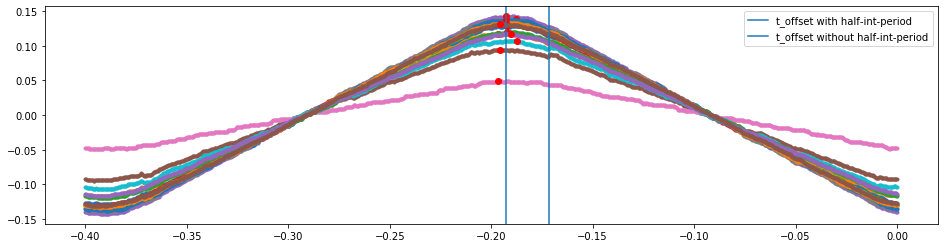

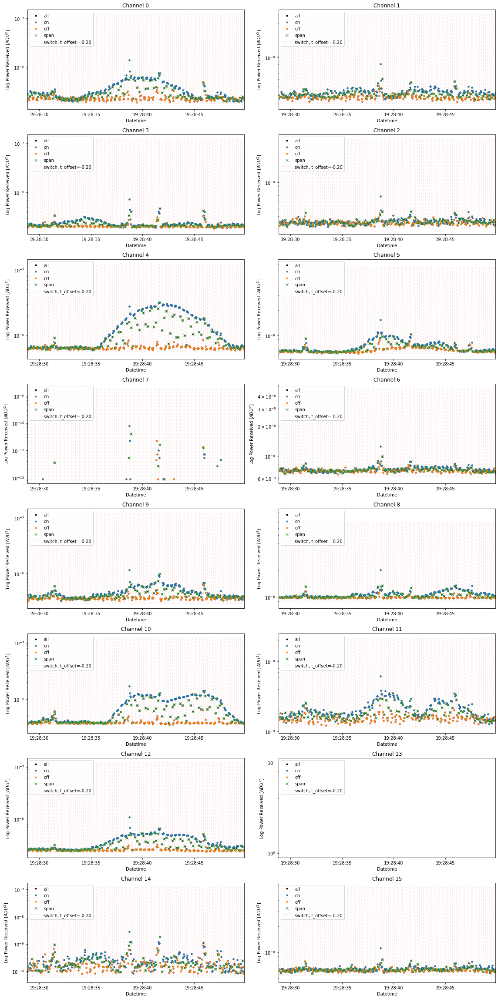

In [16]:
## Initialize CONCAT class and interpolate drone coords:
#pulsedgridconcat=CONCAT(CORRDATCLASS=pulsedgrid200m_corr,DRONEDATCLASS=pulsedgrid200m_drone)

## Find the pulsed source signal: (comment out if source was broadcast continuously)
pulsedgridconcat.Extract_Source_Pulses(Period=0.4e6,\
                                       Dutycycle=0.2e6,\
                                       t_bounds=[10500,11000],\
                                       f_ind=[900],\
                                       half_int_period=0.021)

## Create pulse-averaged visibility matrices: on, off, background subtracted:
#pulsedgridconcat.Perform_Background_Subtraction()

In [ ]:
fig1,[ax1,ax2,ax3]=subplots(nrows=1,ncols=3,figsize=(16,5))
tlb,tub=[0,-1]
ax1.semilogy(pulsedgridconcat.t_index[tlb:tub],pulsedgridconcat.V[tlb:tub,400,0],'.')
ax2.semilogy(pulsedgridconcat.t_index[tlb:tub],pulsedgridconcat.V[tlb:tub,400,1],'.')
ax3.plot(pulsedgridconcat.drone_xyz_LC_interp[tlb:tub,0],pulsedgridconcat.drone_xyz_LC_interp[tlb:tub,1],'.')
tlb,tub=[5050,25350]
ax1.semilogy(pulsedgridconcat.t_index[tlb:tub],pulsedgridconcat.V[tlb:tub,400,0],'.')
ax2.semilogy(pulsedgridconcat.t_index[tlb:tub],pulsedgridconcat.V[tlb:tub,400,1],'.')
ax3.plot(pulsedgridconcat.drone_xyz_LC_interp[tlb:tub,0],pulsedgridconcat.drone_xyz_LC_interp[tlb:tub,1],'.')

In [ ]:
pulsedgridconcat.Plot_Beammap_LC(t_bounds=[5050,25350],\
                                 f_bounds=[900,910],\
                                 coord_args="Pol", #"LC","Pol"\
                                 pulse_args="meanspec_meansub",# None,"on","off","meanspec_on","meanspec_bg","meanspec_meansub"\
                                 cbounds=[],#[1e-11,1e-7], # 1e-11,1e-7 \
                                 dotsize=40)

In [ ]:
from scipy.special import jv

wavelength_m=(3.0*(10.0**8.0))/(pulsedgridconcat.f_arr*1.0e6)
find=900

def Airy_Return_FWHM(theta,params):
    if len(params)==4:
        A,thetaoff,aEff,bg=params
    if len(params)==5:
        A,epsilon,thetaoff,aEff,bg=params 
    if len(params)==6:
        A,epsilon,phioff,thetaoff,aEff,bg=params    
    x_airy=2*np.pi*aEff/wavelength_m[find]*np.sin(theta-thetaoff)
    np.abs((np.abs(x_airy)-1.6133)).argmin()
    return 2.0*np.abs(theta[np.abs((np.abs(x_airy)-1.6133)).argmin()])
    
def Airy_I_Fit(theta,A,thetaoff,aEff,bg):
    x_airy=2*np.pi*aEff/wavelength_m[find]*np.sin(theta-thetaoff)
    return A*((2*jv(1,x_airy)/x_airy)**2.0)+bg

def Airy_I_Fit_obs(theta,A,epsilon,thetaoff,aEff,bg):
    x_airy=2*np.pi*aEff/wavelength_m[find]*np.sin(theta-thetaoff)
    return A*((1.0/((1-(epsilon**2.0))**2.0))*((2/x_airy)*(jv(1,x_airy)-(epsilon*jv(1,epsilon*x_airy))))**2.0)+bg

fig1,[ax1,ax2]=subplots(nrows=2,ncols=1,figsize=(16,6))

xsim=np.linspace((-np.pi/2.0),(np.pi/2.0),10000)
for find in [100,900]:
    ax1.semilogy(xsim,Airy_I_Fit(xsim,1,0,6,0),label="Airy Disk : 6m dish f = {:.2f} MHz".format(pulsedgridconcat.f_arr[find]))
    eps=0.2
    ax2.semilogy(xsim,Airy_I_Fit_obs(xsim,1,eps,0,6,0),label="Obscured [{}] Airy Disk : 6m dish f = {:.2f} MHz".format(eps,pulsedgridconcat.f_arr[find]))
for ax in [ax1,ax2]:
    ax.set_xlabel("theta [rad]")
    ax.legend()

In [ ]:
fig1=figure(figsize=(16,int(6*pulsedgridconcat.n_channels)))
for i in range(pulsedgridconcat.n_channels):
    ax=fig1.add_subplot(int(pulsedgridconcat.n_channels),2,i+1)
    find=850
    tlb,tub=[1250,1750]
    tlb,tub=[1650,1750]
    tlb,tub=[5050,25350] # Full Grid
    #tlb,tub=[14000,17000]
    ## RAW DATA:
    #t_inds=pulsedgridconcat.t_index[tlb:tub]
    #dat0=pulsedgridconcat.V[t_inds,find,i]
    ## MEANSUB DATA:
    t_inds=np.intersect1d(pulsedgridconcat.t_index[tlb:tub],pulsedgridconcat.pulse_t_ind)
    tt=[np.where(pulsedgridconcat.pulse_t_ind==t)[0][0] for t in t_inds]
    dat0=pulsedgridconcat.pulse_V_meansub[tt,find,i]
    theta0=np.sign(np.cos(pulsedgridconcat.drone_rpt_r_per_dish_interp[int(np.floor(i/2)),t_inds,1]))*pulsedgridconcat.drone_rpt_r_per_dish_interp[int(np.floor(i/2)),t_inds,2]
    dat1=dat0[np.where(dat0<=0.95*np.nanmax(dat0))[0]]
    theta1=theta0[np.where(dat0<=0.95*np.nanmax(dat0))[0]]
    dat=dat1[np.where(np.abs(theta1)<=0.7)[0]]
    theta=theta1[np.where(np.abs(theta1)<=0.7)[0]]


    #Amplitude: 
    a0=np.nanmax(dat)
    abounds=[0.0,np.inf]
    #Epsilon (Obscuration ratio): 
    ep0=0.0
    epbounds=[0.0,0.2]
    #Theta Offset:
    thetaoff0=0.0
    thetaoffbounds=[-0.5,0.5]
    #Effective Dish Radius:
    aEff0=3.0
    aEffbounds=[0.0,3.0]
    #Background:
    bg0=0.0
    bgbounds=[0.0,np.inf]
    bgbounds=[0.0,1e-20]
    
    semilogy(180.0/np.pi*theta,dat,'.',alpha=0.5) 

    #INPUT PARAMS & Curve Fitting: Gauss
    #Background:
    sigma0=0.05
    sigmabounds=[0.0,1.0]
    p0=[a0,thetaoff0,sigma0,bg0]
    pbounds=([abounds[0],thetaoffbounds[0],sigmabounds[0],bgbounds[0]],\
             [abounds[1],thetaoffbounds[1],sigmabounds[1],bgbounds[1]])
    popt,pcov=curve_fit(Gauss,theta,dat,p0=p0,bounds=pbounds)
    #print([round(k,5) for k in popt])
    thetasim=np.linspace(np.nanmin(theta),np.nanmax(theta),1000)
    ax.semilogy(180.0/np.pi*thetasim,Gauss(thetasim,*popt),label="Gauss [FWHM = {:.2f} deg]".format(180.0/np.pi*2.355*popt[2]))
    
    #INPUT PARAMS & Curve Fitting: Regular Airy
    p0=[a0,thetaoff0,aEff0,bg0]
    pbounds=([abounds[0],thetaoffbounds[0],aEffbounds[0],bgbounds[0]],\
             [abounds[1],thetaoffbounds[1],aEffbounds[1],bgbounds[1]])
    popt,pcov=curve_fit(Airy_I_Fit,theta,dat,p0=p0,bounds=pbounds)
    #print([round(k,5) for k in popt])
    thetasim=np.linspace(np.nanmin(theta),np.nanmax(theta),1000)
    ax.semilogy(180.0/np.pi*thetasim,Airy_I_Fit(thetasim,*popt),label="Airy [D_eff = {:.2f}m, FWHM = {:.2f} deg]".format(2.0*popt[-2],180.0/np.pi*Airy_Return_FWHM(theta,popt)))
    #INPUT PARAMS & Curve Fitting: Obscured Airy
    p0=[a0,ep0,thetaoff0,aEff0,bg0]
    pbounds=([abounds[0],epbounds[0],thetaoffbounds[0],aEffbounds[0],bgbounds[0]],\
             [abounds[1],epbounds[1],thetaoffbounds[1],aEffbounds[1],bgbounds[1]])
    popt,pcov=curve_fit(Airy_I_Fit_obs,theta,dat,p0=p0,bounds=pbounds)
    #print([round(k,5) for k in popt])
    thetasim=np.linspace(np.nanmin(theta),np.nanmax(theta),1000)
    ax.semilogy(180.0/np.pi*thetasim,Airy_I_Fit_obs(thetasim,*popt),label="Airy_Obsc [D_eff = {:.2f}m, FWHM = {:.2f} deg]".format(2.0*popt[-2],180.0/np.pi*Airy_Return_FWHM(theta,popt)))
    ax.set_ylim(1e-11,1e-5)
    ax.set_title('GBO HIRAX Beam Fits -- [Channel {} @ F={:.2f}MHz]'.format(pulsedgridconcat.chmap[i],pulsedgridconcat.f_arr[find]))
    ax.set_xlabel('Distance from Zenith [$deg$]')
    ax.set_ylabel('Background Subtracted Pulse Power [$ADU^2$]')
    ax.legend(loc=1)
tight_layout()

In [245]:
## Thursday 100m Pulsed Grid Flight w/ 16 Channels / 8 Dishes:

## Initialize correlator data class and pull auto correlations:
gaindir='/hirax/GBO_Data/TONE_ACQ/digital_gains/20210826T195003Z_yale_drone_yale_digitalgain/'
datadir='/hirax/GBO_Data/Emilys_Rsync/processed/20210826T195003Z_yale_drone/corr/20210826T195014Z/'

main_beam_corr=Corr_Data(n_channels=16,\
                              chmap=GBO8_chmap,\
                              Data_Directory=datadir,\
                              Working_Directory=workingdir,\
                                Data_File_Index=range(95), # last 2 files are worthless (power outage) \
                              Gain_Directory=gaindir)

Initializing Correlator Class using:
 --> /hirax/GBO_Data/Emilys_Rsync/processed/20210826T195003Z_yale_drone/corr/20210826T195014Z/
 --> Arrays initialized with shape (95, 256, 1023, 16)
Assigning array values by reading in data files:
 --> Loading File: 0094_processed/0096_processed

In [248]:
## Read Drone Data: 
drone_directory='/hirax/all_drone_data/datcon_csv/'
ndishes=8
main_beam_drone=Drone_Data(dronedir=drone_directory,\
                                FLYTAG='FLY536.csv',\
                                Origin_llh=GBO_HIRAX_DISH_0,\
                                Origin_key='Hirax_Dish_0',\
                                dkeys=Array_Keys[:ndishes],\
                                dcoords=Array_Coords[:ndishes],\
                                dpointings=Array_Pointings[:ndishes],\
                                dpols=Array_Pols[:ndishes])

Initializing drone data via datcon_csv routine: FLY536.csv
Interpolating time starting at 2021-08-26T19:50:28Z
generating llh, geocentric cartesian, local cartesian, and local spherical coordinates.
generating dish and receiver line of sight coordinates.


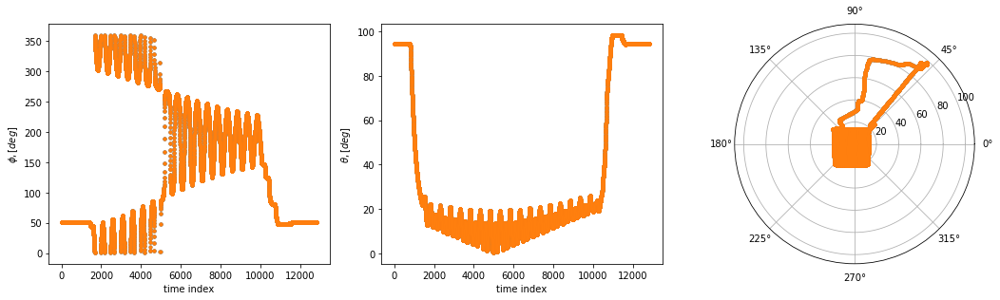

In [1370]:
#main_beam_drone.Plot_Drone_Coordinates(t_cut=True,t_bounds=[1600,10100])
#main_beam_drone.Plot_Polar_Lines_of_Sight(t_bounds=[1600,10100])
main_beam_drone.Plot_Angular_Coordinates()

In [406]:
## Initialize CONCAT class and interpolate drone coords:
mainbeamconcat=CONCAT(CORRDATCLASS=main_beam_corr,DRONEDATCLASS=main_beam_drone)

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Data/Emilys_Rsync/processed/20210826T195003Z_yale_drone/corr/20210826T195014Z/
 --> FLY536.csv


/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:43: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:44: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future


Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 23980 elements
  --> drone timestamp axis contains 12842 elements


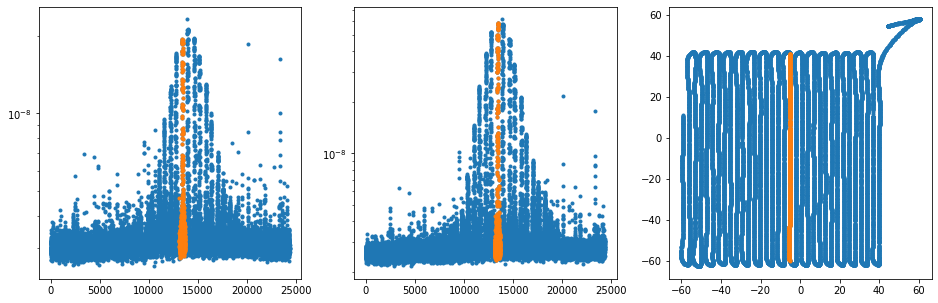

In [435]:
fig1,[ax1,ax2,ax3]=subplots(nrows=1,ncols=3,figsize=(16,5))
tlb,tub=[0,-1]
#tlb,tub=[4125,24000]
ax1.semilogy(mainbeamconcat.t_index[tlb:tub],mainbeamconcat.V[tlb:tub,400,0],'.')
ax2.semilogy(mainbeamconcat.t_index[tlb:tub],mainbeamconcat.V[tlb:tub,400,1],'.')
ax3.plot(mainbeamconcat.drone_xyz_LC_interp[tlb:tub,0],mainbeamconcat.drone_xyz_LC_interp[tlb:tub,1],'.')
tlb,tub=[13100,13650]
ax1.semilogy(mainbeamconcat.t_index[tlb:tub],mainbeamconcat.V[tlb:tub,400,0],'.')
ax2.semilogy(mainbeamconcat.t_index[tlb:tub],mainbeamconcat.V[tlb:tub,400,1],'.')
ax3.plot(mainbeamconcat.drone_xyz_LC_interp[tlb:tub,0],mainbeamconcat.drone_xyz_LC_interp[tlb:tub,1],'.')

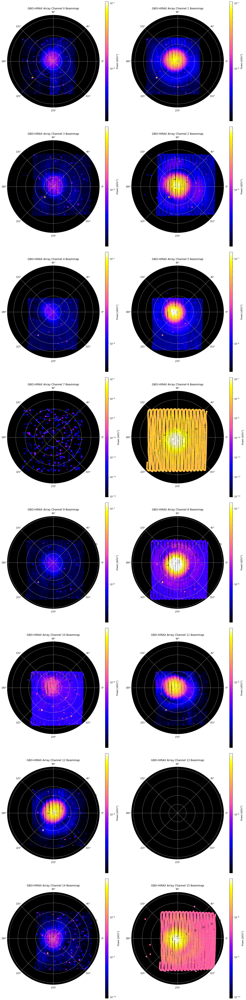

In [438]:
mainbeamconcat.Plot_Beammap_LC(t_bounds=[4125,24000],\
                                 f_bounds=[900,910],\
                                 coord_args="Pol", #"LC","Pol"\
                                 pulse_args="on",# None,"on","off","meanspec_on","meanspec_bg","meanspec_meansub"\
                                 cbounds=[],#[1e-11,1e-7], # 1e-11,1e-7 \
                                 dotsize=40)

/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:96: RuntimeWarning: All-NaN slice encountered


Maximum Pearson_R Correlations:
  --> t_indices = [466. 480. 501. 473. 465. 480. 122. 479. 466. 480. 464. 481. 481.  nan
 501. 473.]
  --> t_offsets = [-0.21341341 -0.20780781 -0.1993994  -0.21061061 -0.21381381 -0.20780781
 -0.35115115 -0.20820821 -0.21341341 -0.20780781 -0.21421421 -0.20740741
 -0.20740741         nan -0.1993994  -0.21061061]
Selecting global time offset:
  --> global_t_offset = -0.1872082082
Finding relevant pulsing indices and checking for overlaps:
  --> on/off ind intersection: []
  --> on/span ind intersection: []
  --> off/span ind intersection: []


/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:130: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:131: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:132: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:133: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:134: UserWarning: Data has no positive values, and therefore cannot be log-scaled.


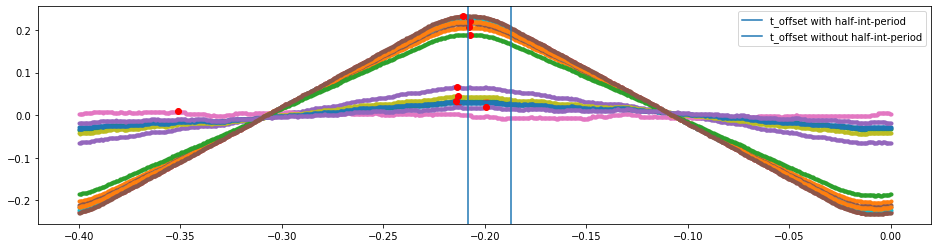

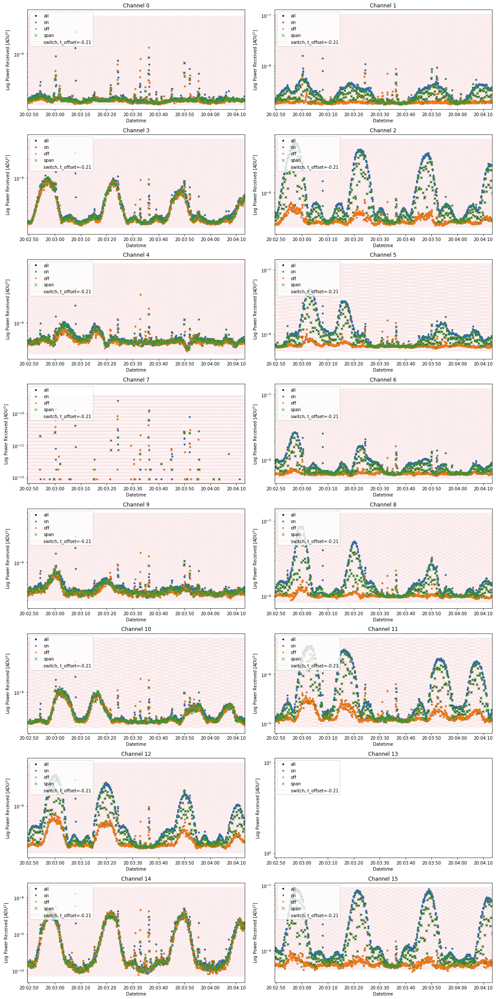

In [407]:
## Find the pulsed source signal: (comment out if source was broadcast continuously)
mainbeamconcat.Extract_Source_Pulses(Period=0.4e6,\
                                       Dutycycle=0.2e6,\
                                       t_bounds=[18000,20000],\
                                       f_ind=[905],\
                                       half_int_period=0.021)

In [408]:
mainbeamconcat.Perform_Background_Subtraction()

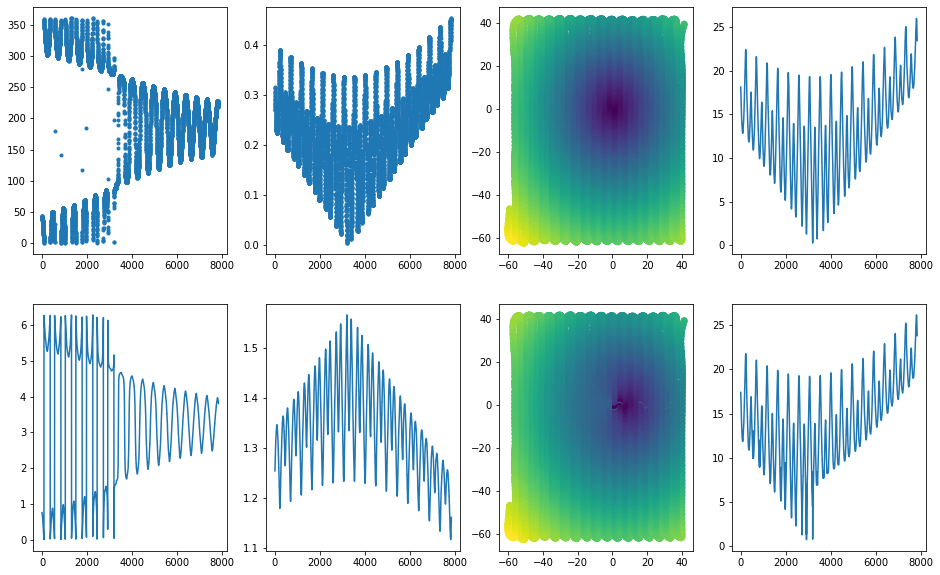

In [1006]:
fig1,[[ax1,ax2,ax3,ax4],[ax5,ax6,ax7,ax8]]=subplots(nrows=2,ncols=4,figsize=(16,10))
ax1.plot(180/np.pi*mainbeamconcat.drone_rpt_r_per_dish_interp[int(np.floor(i/2)),t_inds,1],'.')
ax2.plot((mainbeamconcat.drone_rpt_r_per_dish_interp[int(np.floor(i/2)),t_inds,2]),'.')

phi1=(np.pi/2.0)-(mainbeamconcat.drone_rpt_r_per_dish_interp[:,t_inds,2])
ax6.plot(phi1[0,:])
theta1=mainbeamconcat.drone_rpt_r_per_dish_interp[:,t_inds,1]
ax5.plot(theta1[0,:])
phi2=90.0*np.pi/180.0
theta2=0.0*np.pi/180.0
i=0
for i in range(8)[0:1]:
    ax3.scatter(mainbeamconcat.drone_xyz_LC_interp[t_inds,0],mainbeamconcat.drone_xyz_LC_interp[t_inds,1],\
                c=180.0/np.pi*2.0*np.arcsin(np.sqrt((np.sin((phi1[i,:]-phi2)/2.0)**2.0)+\
                                   np.cos(phi1[i,1])*np.cos(phi2)*(np.sin((theta1[i,:]-theta2)/2.0)**2.0))))
    ax4.plot(180.0/np.pi*2.0*np.arcsin(np.sqrt((np.sin((phi1[i,:]-phi2)/2.0)**2.0)+\
                                   np.cos(phi1[i,1])*np.cos(phi2)*(np.sin((theta1[i,:]-theta2)/2.0)**2.0))))

phi2=(89.0)*np.pi/180.0
theta2=0.0*np.pi/180.0
for i in range(8)[0:1]:
    ax7.scatter(mainbeamconcat.drone_xyz_LC_interp[t_inds,0],mainbeamconcat.drone_xyz_LC_interp[t_inds,1],\
                c=180.0/np.pi*2.0*np.arcsin(np.sqrt((np.sin((phi1[i,:]-phi2)/2.0)**2.0)+\
                                   np.cos(phi1[i,1])*np.cos(phi2)*(np.sin((theta1[i,:]-theta2)/2.0)**2.0))))
    ax8.plot(180.0/np.pi*2.0*np.arcsin(np.sqrt((np.sin((phi1[i,:]-phi2)/2.0)**2.0)+\
                                   np.cos(phi1[i,1])*np.cos(phi2)*(np.sin((theta1[i,:]-theta2)/2.0)**2.0))))

/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:52: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:64: UserWarning: Data has no positive values, and therefore cannot be log-scaled.


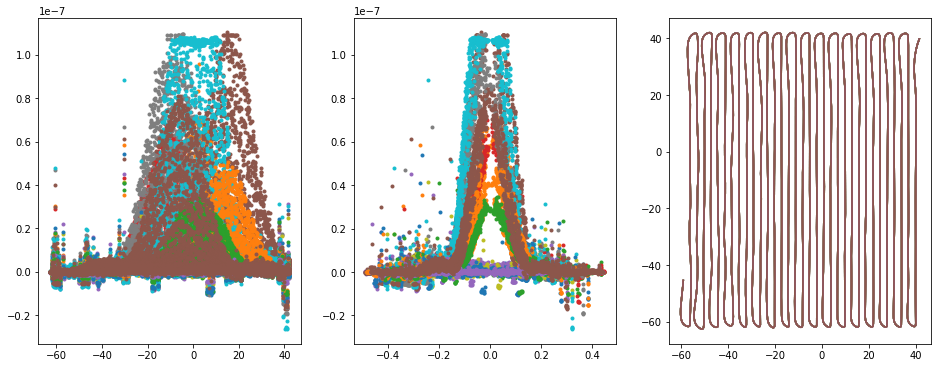

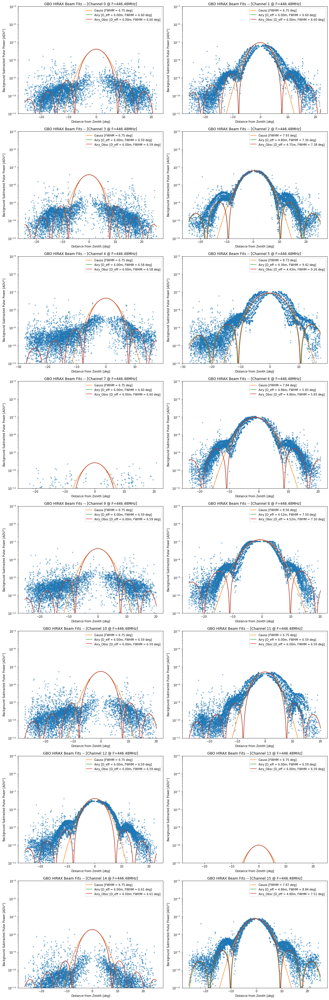

In [700]:
fig0,[ax1,ax2,ax3]=subplots(nrows=1,ncols=3,figsize=(16,6))
fig1=figure(figsize=(16,int(6*mainbeamconcat.n_channels)))
for i in range(mainbeamconcat.n_channels):
    ax=fig1.add_subplot(int(mainbeamconcat.n_channels),2,i+1)
    find=905
    tlb,tub=[1250,1750]
    tlb,tub=[1650,1750]
    tlb,tub=[4125,24000] # Full Grid
    #tlb,tub=[14000,17000]
    #tlb,tub=[13100,13650]
    ## RAW DATA:
    t_inds=mainbeamconcat.t_index[tlb:tub]
    dat0=mainbeamconcat.V[t_inds,find,i]
    ## MEANSUB DATA:
    t_inds=np.intersect1d(mainbeamconcat.t_index[tlb:tub],mainbeamconcat.inds_on)
    dat0=mainbeamconcat.V_meansub[t_inds,find,i]
    theta0=np.sign(np.sin(mainbeamconcat.drone_rpt_r_per_dish_interp[int(np.floor(i/2)),t_inds,1]))*mainbeamconcat.drone_rpt_r_per_dish_interp[int(np.floor(i/2)),t_inds,2]
    ## Cut saturation points:
    dat1=dat0[np.where(dat0<=0.99*np.nanmax(dat0))[0]]
    theta1=theta0[np.where(dat0<=0.99*np.nanmax(dat0))[0]]
    ## Cut angle outliers?
    dat=dat1[np.where(np.abs(theta1)<=0.7)[0]]
    theta=theta1[np.where(np.abs(theta1)<=0.7)[0]]
    dat=dat0
    theta=theta0
    
    
    
    
    ax1.plot(mainbeamconcat.drone_xyz_LC_interp[tlb:tub,1],mainbeamconcat.V_meansub[tlb:tub,find,i],'.')
    ax2.plot(theta,dat,'.')
    ax3.plot(mainbeamconcat.drone_xyz_LC_interp[tlb:tub,0],mainbeamconcat.drone_xyz_LC_interp[tlb:tub,1])


    #Amplitude: 
    a0=np.nanmax(dat)
    abounds=[0.0,np.inf]
    #Epsilon (Obscuration ratio): 
    ep0=0.0
    epbounds=[0.0,0.2]
    #Theta Offset:
    thetaoff0=0.0
    thetaoffbounds=[-0.5,0.5]
    #Effective Dish Radius:
    aEff0=3.0
    aEffbounds=[0.0,3.0]
    #Background:
    bg0=0.0
    bgbounds=[0.0,np.inf]
    bgbounds=[0.0,1e-20]
    
    semilogy(180.0/np.pi*theta,dat,'.',alpha=0.5) 

    #INPUT PARAMS & Curve Fitting: Gauss
    #Background:
    sigma0=0.05
    sigmabounds=[0.0,1.0]
    p0=[a0,thetaoff0,sigma0,bg0]
    pbounds=([abounds[0],thetaoffbounds[0],sigmabounds[0],bgbounds[0]],\
             [abounds[1],thetaoffbounds[1],sigmabounds[1],bgbounds[1]])
    popt,pcov=curve_fit(Gauss,theta,dat,p0=p0,bounds=pbounds)
    #print([round(k,5) for k in popt])
    thetasim=np.linspace(np.nanmin(theta),np.nanmax(theta),1000)
    ax.semilogy(180.0/np.pi*thetasim,Gauss(thetasim,*popt),label="Gauss [FWHM = {:.2f} deg]".format(180.0/np.pi*2.355*popt[2]))
    
    #INPUT PARAMS & Curve Fitting: Regular Airy
    p0=[a0,thetaoff0,aEff0,bg0]
    pbounds=([abounds[0],thetaoffbounds[0],aEffbounds[0],bgbounds[0]],\
             [abounds[1],thetaoffbounds[1],aEffbounds[1],bgbounds[1]])
    popt,pcov=curve_fit(Airy_I_Fit,theta,dat,p0=p0,bounds=pbounds)
    #print([round(k,5) for k in popt])
    thetasim=np.linspace(np.nanmin(theta),np.nanmax(theta),1000)
    ax.semilogy(180.0/np.pi*thetasim,Airy_I_Fit(thetasim,*popt),label="Airy [D_eff = {:.2f}m, FWHM = {:.2f} deg]".format(2.0*popt[-2],180.0/np.pi*Airy_Return_FWHM(theta,popt)))
    #INPUT PARAMS & Curve Fitting: Obscured Airy
    p0=[a0,ep0,thetaoff0,aEff0,bg0]
    pbounds=([abounds[0],epbounds[0],thetaoffbounds[0],aEffbounds[0],bgbounds[0]],\
             [abounds[1],epbounds[1],thetaoffbounds[1],aEffbounds[1],bgbounds[1]])
    popt,pcov=curve_fit(Airy_I_Fit_obs,theta,dat,p0=p0,bounds=pbounds)
    #print([round(k,5) for k in popt])
    thetasim=np.linspace(np.nanmin(theta),np.nanmax(theta),1000)
    ax.semilogy(180.0/np.pi*thetasim,Airy_I_Fit_obs(thetasim,*popt),label="Airy_Obsc [D_eff = {:.2f}m, FWHM = {:.2f} deg]".format(2.0*popt[-2],180.0/np.pi*Airy_Return_FWHM(theta,popt)))
    ax.set_ylim(1e-11,1e-5)
    ax.set_title('GBO HIRAX Beam Fits -- [Channel {} @ F={:.2f}MHz]'.format(mainbeamconcat.chmap[i],mainbeamconcat.f_arr[find]))
    ax.set_xlabel('Distance from Zenith [$deg$]')
    ax.set_ylabel('Background Subtracted Pulse Power [$ADU^2$]')
    ax.legend(loc=1)
tight_layout()

In [829]:
def Ang_Dist(phitheta,phioff,thetaoff):
    phi1=np.pi/2-phitheta[:,1]
    theta1=phitheta[:,0]
    phi2=phioff
    theta2=thetaoff
    angdist=2.0*np.arcsin(np.sqrt((np.sin((phi1-phi2)/2.0)**2.0)+np.cos(phi1)*np.cos(phi2)*(np.sin((theta1-theta2)/2.0)**2.0)))
    return angdist
    
def Airy_I_Fit_obs_2d(phitheta,A,epsilon,phioff,thetaoff,aEff,bg):
    phi1=np.pi/2-phitheta[:,1]
    theta1=phitheta[:,0]
    phi2=phioff
    theta2=thetaoff
    angdist=2.0*np.arcsin(np.sqrt((np.sin((phi1-phi2)/2.0)**2.0)+np.cos(phi1)*np.cos(phi2)*(np.sin((theta1-theta2)/2.0)**2.0)))
    x_airy=2*np.pi*aEff/wavelength_m[find]*np.sin(angdist)
    return A*((1.0/((1-(epsilon**2.0))**2.0))*((2/x_airy)*(jv(1,x_airy)-(epsilon*jv(1,epsilon*x_airy))))**2.0)+bg


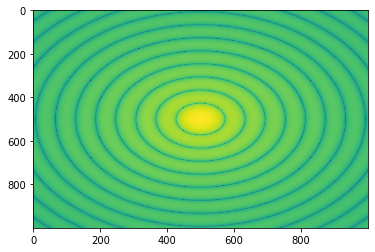

In [830]:
from astropy.modeling.models import AiryDisk2D

AD=AiryDisk2D(1,5,5,radius=1)
x=np.linspace(-60,60,1000)
y=np.linspace(-60,60,1000)
dat=np.zeros((len(x),len(y)))
for i,val in enumerate(x):
    dat[i]=AD.evaluate(val,y,10,0,0,radius=8.75)
    
imshow(dat,aspect="auto",norm=LogNorm())

In [1064]:
def Airy_2d_LC_opt(P,x,y,V):
    amp,x0,y0,rad=P
    return AD.evaluate(x,y,amp,x0,y0,rad)-V

def Gauss_2d_LC_opt(P,x,y,V):
    amp,x0,xsig,y0,ysig=P
    return amp*np.exp(-0.5*((((x-x0)/xsig)**2.0)+(((y-y0)/ysig)**2.0)))-V

def Gauss_2d_LC_func(P,x,y):
    amp,x0,xsig,y0,ysig=P
    return amp*np.exp(-0.5*((((x-x0)/xsig)**2.0)+(((y-y0)/ysig)**2.0)))

In [1103]:
2*180.0/np.pi*np.arctan(1.616/3.832*AFit.x[3]/np.nanmean(mbz))


7.645218249390791

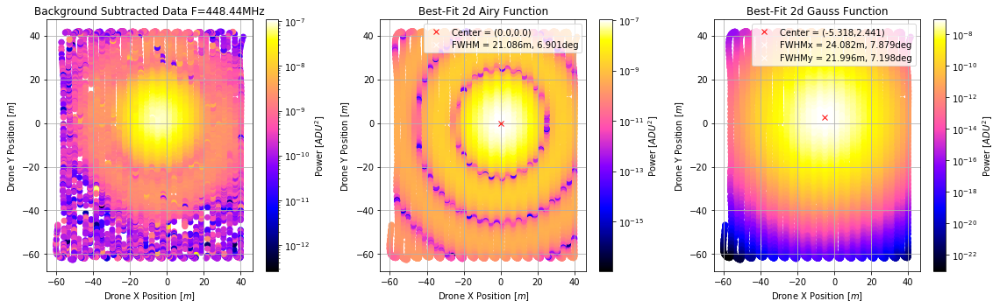

In [1296]:
tlb,tub=[4125,24000] # Full Grid
t_inds=np.intersect1d(mainbeamconcat.t_index[tlb:tub],mainbeamconcat.inds_on)
find=900
mbx=mainbeamconcat.drone_xyz_LC_interp[t_inds,0]
mby=mainbeamconcat.drone_xyz_LC_interp[t_inds,1]
mbz=mainbeamconcat.drone_xyz_LC_interp[t_inds,2]
mbV=mainbeamconcat.V_meansub[t_inds,find,1]
mb_input_data=np.array([mbx,mby,mbV])
## shared params:
amp0=np.nanmax(mbV)
x00=0.0
y00=0.0
## airy params:
rad0=25.0
## 2dgauss params:
xsig0=6.0
ysig0=6.0
pA=np.array([amp0,x00,y00,rad0])
BA=(np.array([0,-50,-50,0]),np.array([np.inf,50,50,50]))
pG=np.array([amp0,x00,xsig0,y00,ysig0])
BG=(np.array([0,-50,0,-50,0]),np.array([np.inf,50,50,50,50]))
AFit=least_squares(Airy_2d_LC_opt,x0=pA,bounds=BA,args=mb_input_data)
GFit=least_squares(Gauss_2d_LC_opt,x0=pG,bounds=BG,args=mb_input_data)

#AD.evaluate(mainbeamconcat.drone_xyz_LC_interp[:,0],mainbeamconcat.drone_xyz_LC_interp[:,1],10,0,0,radius=5)
fig1,[ax1,ax2,ax3]=subplots(nrows=1,ncols=3,figsize=(16,5))
im1=ax1.scatter(mbx,mby,c=mbV,cmap='gnuplot2',norm=LogNorm())
ax1.set_title("Background Subtracted Data F={}MHz".format(np.round(mainbeamconcat.f_arr[find],2)))
cbar1=fig1.colorbar(im1,ax=ax1)
cbar1.set_label('Power [$ADU^2$]')

im2=ax2.scatter(mbx,mby,c=AD.evaluate(mbx,mby,AFit.x[0],AFit.x[1],AFit.x[2],radius=AFit.x[3]),cmap='gnuplot2',norm=LogNorm())
ax2.set_title("Best-Fit 2d Airy Function")
ax2.plot(AFit.x[1],AFit.x[2],'rx',label="Center = ({},{})".format(np.round(AFit.x[1],3),np.round(AFit.x[2],3)))
Afwhmm=2*1.616/3.832*AFit.x[3]
Afwhmd=2*180.0/np.pi*np.arctan(1.616/3.832*AFit.x[3]/np.nanmean(mbz))
ax2.plot([],[],'wx',label="FWHM = {}m, {}deg".format(np.round(Afwhmm,3),np.round(Afwhmd,3)))
ax2.legend(loc=1)
cbar2=fig1.colorbar(im2,ax=ax2)
cbar2.set_label('Power [$ADU^2$]')

im3=ax3.scatter(mbx,mby,c=Gauss_2d_LC_func(GFit.x,mbx,mby),cmap='gnuplot2',norm=LogNorm())
ax3.set_title("Best-Fit 2d Gauss Function")
ax3.plot(GFit.x[1],GFit.x[3],'rx',label="Center = ({},{})".format(np.round(GFit.x[1],3),np.round(GFit.x[3],3)))
Gfwhmxm=2.355*GFit.x[2]
Gfwhmxd=2*180.0/np.pi*np.arctan(0.5*2.355*GFit.x[2]/np.nanmean(mbz))
Gfwhmym=2.355*GFit.x[4]
Gfwhmyd=2*180.0/np.pi*np.arctan(0.5*2.355*GFit.x[4]/np.nanmean(mbz))
ax3.plot([],[],'wx',label="FWHMx = {}m, {}deg".format(np.round(Gfwhmxm,3),np.round(Gfwhmxd,3)))
ax3.plot([],[],'wx',label="FWHMy = {}m, {}deg".format(np.round(Gfwhmym,3),np.round(Gfwhmyd,3)))
cbar3=fig1.colorbar(im3,ax=ax3)
cbar3.set_label('Power [$ADU^2$]')
ax3.legend(loc=1)

for ax in [ax1,ax2,ax3]:
    ax.set_xlabel('Drone X Position [$m$]')
    ax.set_ylabel('Drone Y Position [$m$]')
    ax.grid()
tight_layout()


In [1324]:
tlb,tub=[4125,24000] # Full Grid
t_inds=np.intersect1d(mainbeamconcat.t_index[tlb:tub],mainbeamconcat.inds_on)

AFit_f_params=np.zeros((mainbeamconcat.n_channels,len(mainbeamconcat.f_arr),4))
GFit_f_params=np.zeros((mainbeamconcat.n_channels,len(mainbeamconcat.f_arr),5))
for k in range(mainbeamconcat.n_channels):
    print(k)
    for find,freq in enumerate(mainbeamconcat.f_arr):
        mbx=mainbeamconcat.drone_xyz_LC_interp[t_inds,0]
        mby=mainbeamconcat.drone_xyz_LC_interp[t_inds,1]
        mbz=mainbeamconcat.drone_xyz_LC_interp[t_inds,2]
        mbV=mainbeamconcat.V_meansub[t_inds,find,k]
        mb_input_data=np.array([mbx,mby,mbV])
        ## shared params:
        amp0=np.nanmax(mbV)
        x00=Array_Coords[int(k/2),0]
        y00=Array_Coords[int(k/2),1]
        ## airy params:
        rad0=25.0
        ## 2dgauss params:
        xsig0=6.0
        ysig0=6.0
        pA=np.array([amp0,x00,y00,rad0])
        BA=(np.array([0.0,-50.0,-50.0,0.0]),np.array([1e-6,50,50,50]))
        pG=np.array([amp0,x00,xsig0,y00,ysig0])
        BG=(np.array([0.0,-30.0,0.0,-30.0,0.0]),np.array([1e-6,30,50,30,50]))
        AFit_f_params[k,find,:]=least_squares(Airy_2d_LC_opt,x0=pA,args=mb_input_data).x
        GFit_f_params[k,find,:]=least_squares(Gauss_2d_LC_opt,x0=pG,args=mb_input_data).x

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15


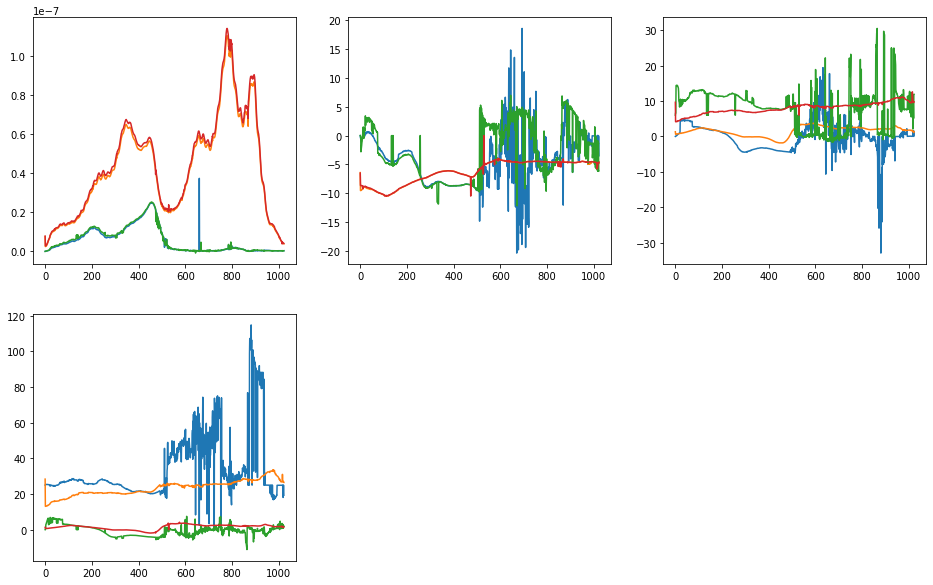

In [1325]:
fig1=figure(figsize=(16,10))

for k in [0,1,2,3]:
    ax=fig1.add_subplot(2,3,k+1)
    plot(AFit_f_params[0,:,k])
    plot(AFit_f_params[1,:,k])
    plot(GFit_f_params[0,:,k])
    plot(GFit_f_params[1,:,k])


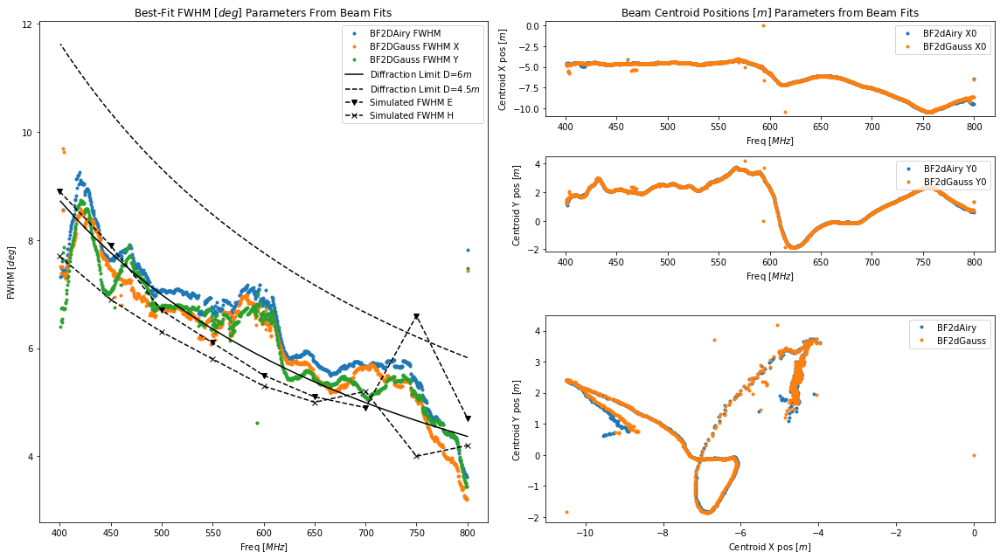

In [1326]:
## Use the returned fit parameters to plot FWHM and centroid for these fits:
    # Airy Fit Parameter array:  pA=np.array([amp0,x00,y00,rad0])
    # Gauss Fit Parameter array: pG=np.array([amp0,x00,xsig0,y00,ysig0])

## FWHM in meters (x,y) and degrees in FoV:
Afwhmm_f=2*1.616/3.832*AFit_f_params[:,:,3]
Afwhmd_f=2*180.0/np.pi*np.arctan(1.616/3.832*AFit_f_params[:,:,3]/np.nanmean(mbz))
Gfwhmxm_f=2.355*GFit_f_params[:,:,2]
Gfwhmxd_f=2*180.0/np.pi*np.arctan(0.5*2.355*GFit_f_params[:,:,2]/np.nanmean(mbz))
Gfwhmym_f=2.355*GFit_f_params[:,:,4]
Gfwhmyd_f=2*180.0/np.pi*np.arctan(0.5*2.355*GFit_f_params[:,:,4]/np.nanmean(mbz))

## Centroid Location in meters (x,y) and degrees:
ACent_f=AFit_f_params[:,:,[1,2]]
ACentd_f=np.arctan(AFit_f_params[:,:,[1,2]]/np.nanmean(mbz))
GCent_f=GFit_f_params[:,:,[1,3]]
GCentd_f=np.arctan(GFit_f_params[:,:,[1,3]]/np.nanmean(mbz))

wavelength_m=(3.0*(10.0**8.0))/(pulsedgridconcat.f_arr*1.0e6)
difflimit=180.0/np.pi*1.22*wavelength_m

fwhms_bensims_f=np.linspace(400,800,9)
fwhms_bensims_E = [8.9, 7.9, 6.7, 6.1, 5.5, 5.1, 4.9, 6.6, 4.7]
fwhms_bensims_H = [7.7, 6.9, 6.3, 5.8, 5.3, 5, 5.2, 4, 4.2]
    
g=1    
    
fig1=figure(figsize=(16,9))
ax1=fig1.add_subplot(1,2,1)
ax1.plot(mainbeamconcat.f_arr,Afwhmd_f[g],'.',label="BF2DAiry FWHM")
ax1.plot(mainbeamconcat.f_arr,Gfwhmxd_f[g],'.',label="BF2DGauss FWHM X")
ax1.plot(mainbeamconcat.f_arr,Gfwhmyd_f[g],'.',label="BF2DGauss FWHM Y")
ax1.plot(mainbeamconcat.f_arr,difflimit/6.0,'k-',markersize=0.5,label="Diffraction Limit D=6$m$")
ax1.plot(mainbeamconcat.f_arr,difflimit/4.5,'k--',markersize=0.5,label="Diffraction Limit D=4.5$m$")
ax1.plot(fwhms_bensims_f,fwhms_bensims_E,'kv--',label="Simulated FWHM E")
ax1.plot(fwhms_bensims_f,fwhms_bensims_H,'kx--',label="Simulated FWHM H")
ax1.legend(loc=1)
ax1.set_ylabel("FWHM [$deg$]")
ax1.set_xlabel("Freq [$MHz$]")
ax1.set_title("Best-Fit FWHM [$deg$] Parameters From Beam Fits")



ax2=fig1.add_subplot(4,2,2)
ax2.plot(mainbeamconcat.f_arr,ACent_f[g,:,0],'.',label='BF2dAiry X0')
ax2.plot(mainbeamconcat.f_arr,GCent_f[g,:,0],'.',label='BF2dGauss X0')
ax2.set_ylabel("Centroid X pos [$m$]")
ax2.set_xlabel("Freq [$MHz$]")
ax2.set_title("Beam Centroid Positions [$m$] Parameters from Beam Fits")
ax2.legend(loc=1)

ax3=fig1.add_subplot(4,2,4)
ax3.plot(mainbeamconcat.f_arr,ACent_f[g,:,1],'.',label='BF2dAiry Y0')
ax3.plot(mainbeamconcat.f_arr,GCent_f[g,:,1],'.',label='BF2dGauss Y0')
ax3.set_ylabel("Centroid Y pos [$m$]")
ax3.set_xlabel("Freq [$MHz$]")
ax3.legend(loc=1)

ax4=fig1.add_subplot(2,2,4)
ax4.plot(ACent_f[g,:,0],ACent_f[g,:,1],'.',label='BF2dAiry')
ax4.plot(GCent_f[g,:,0],GCent_f[g,:,1],'.',label='BF2dGauss')
ax4.set_xlabel("Centroid X pos [$m$]")
ax4.set_ylabel("Centroid Y pos [$m$]")
ax4.legend(loc=1)




tight_layout()



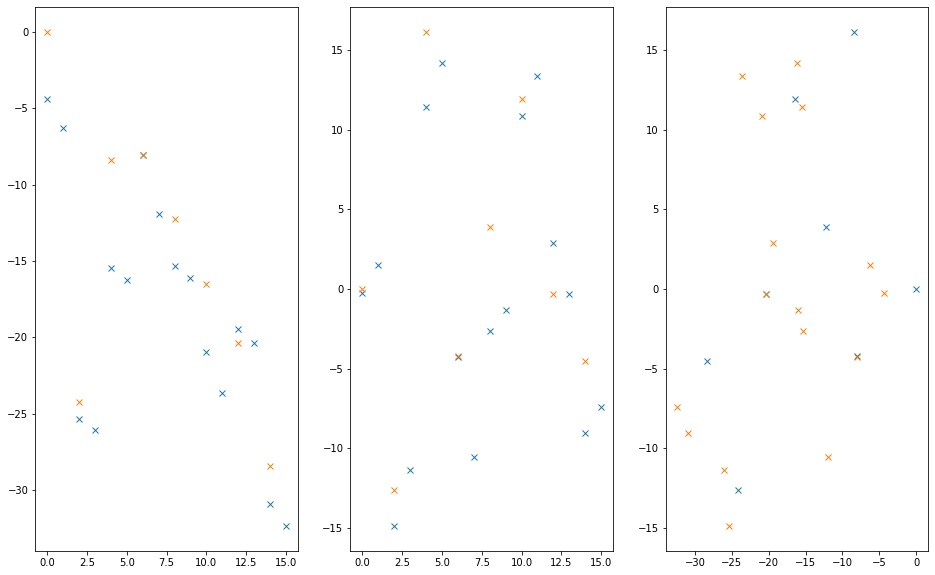

In [1328]:
fig1,[ax1,ax2,ax3]=subplots(nrows=1,ncols=3,figsize=(16,10))
ax1.plot(np.nanmean(ACent_f[:,:,0],axis=1),'x')
ax1.plot([0,2,4,6,8,10,12,14],Array_Coords[:,0],'x')
ax2.plot(np.nanmean(ACent_f[:,:,1],axis=1),'x')
ax2.plot([0,2,4,6,8,10,12,14],Array_Coords[:,1],'x')
ax3.plot(Array_Coords[:,0],Array_Coords[:,1],'x')
ax3.plot(np.nanmean(ACent_f[:,:,0],axis=1),np.nanmean(ACent_f[:,:,1],axis=1),'x')



NameError: name 'stop' is not defined

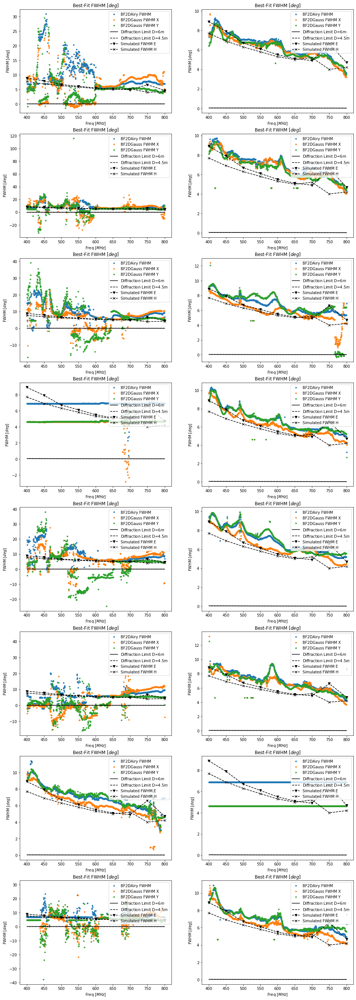

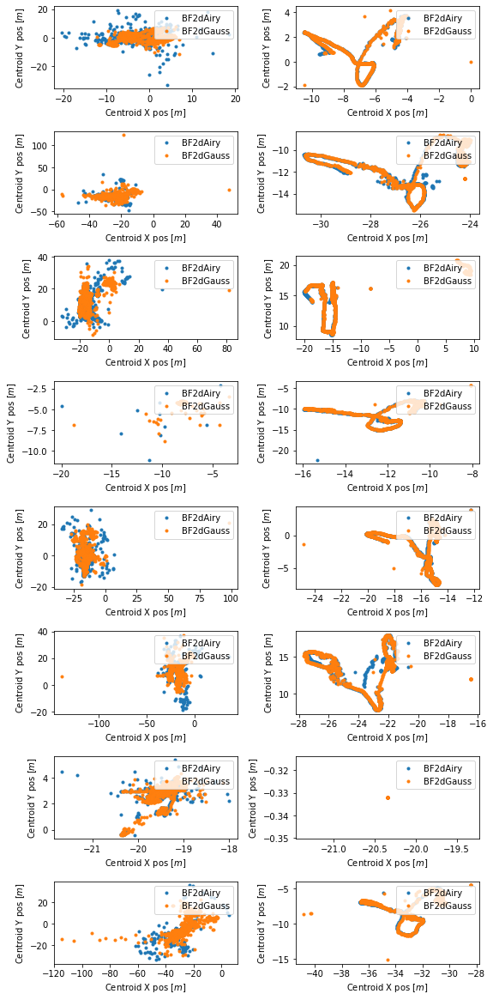

In [1393]:
fig1=figure(figsize=(16,6*int(AFit_f_params.shape[0]/2.0)))
for k in range(AFit_f_params.shape[0]):
    ax1=fig1.add_subplot(int(AFit_f_params.shape[0]/2.0),2,int(k)+1)
    ax1.plot(mainbeamconcat.f_arr,Afwhmd_f[k],'.',label="BF2DAiry FWHM")
    ax1.plot(mainbeamconcat.f_arr,Gfwhmxd_f[k],'.',label="BF2DGauss FWHM X")
    ax1.plot(mainbeamconcat.f_arr,Gfwhmyd_f[k],'.',label="BF2DGauss FWHM Y")
    ax1.plot(mainbeamconcat.f_arr,difflimit/6.0,'k-',markersize=0.5,label="Diffraction Limit D=6$m$")
    ax1.plot(mainbeamconcat.f_arr,difflimit/4.5,'k--',markersize=0.5,label="Diffraction Limit D=4.5$m$")
    ax1.plot(fwhms_bensims_f,fwhms_bensims_E,'kv--',label="Simulated FWHM E")
    ax1.plot(fwhms_bensims_f,fwhms_bensims_H,'kx--',label="Simulated FWHM H")
    ax1.legend(loc=1)
    ax1.set_ylabel("FWHM [$deg$]")
    ax1.set_xlabel("Freq [$MHz$]")
    ax1.set_title("Best-Fit FWHM [$deg$]")
    
fig2=figure(figsize=(8,4*int(AFit_f_params.shape[0]/2.0)))
#fig2=figure(figsize=(16,16))
#ax4=fig2.add_subplot(1,1,1)
#carr=cm.gnuplot2(np.linspace(0,1,18))
for k in range(AFit_f_params.shape[0]):
    ax4=fig2.add_subplot(int(AFit_f_params.shape[0]),2,int(k)+1)
    ax4.plot(ACent_f[k,:,0],ACent_f[k,:,1],'.',label='BF2dAiry')
    ax4.plot(GCent_f[k,:,0],GCent_f[k,:,1],'.',label='BF2dGauss')
    ax4.set_xlabel("Centroid X pos [$m$]")
    ax4.set_ylabel("Centroid Y pos [$m$]")
    ax4.legend(loc=1)
tight_layout()

stop

fig3=figure(figsize=(16,6*int(AFit_f_params.shape[0]/2.0)))
for k in range(AFit_f_params.shape[0]):
    ax1=fig2.add_subplot(int(2*AFit_f_params.shape[0]),4,int(8*k)+2)
    ax1.plot(mainbeamconcat.f_arr,ACent_f[g,:,0],'.',label='BF2dAiry X0')
    ax1.plot(mainbeamconcat.f_arr,GCent_f[g,:,0],'.',label='BF2dGauss X0')
    ax1.set_ylabel("Centroid X pos [$m$]")
    ax1.set_xlabel("Freq [$MHz$]")
    ax1.set_title("Beam Centroid Positions [$m$]")
    ax1.legend(loc=1)
    
    ax3=fig2.add_subplot(int(2*AFit_f_params.shape[0]),4,int(8*k)+6)
    ax3.plot(mainbeamconcat.f_arr,ACent_f[g,:,1],'.',label='BF2dAiry Y0')
    ax3.plot(mainbeamconcat.f_arr,GCent_f[g,:,1],'.',label='BF2dGauss Y0')
    ax3.set_ylabel("Centroid Y pos [$m$]")
    ax3.set_xlabel("Freq [$MHz$]")
    ax3.legend(loc=1)

    ax4=fig2.add_subplot(int(AFit_f_params.shape[0]),4,int(4*k)+6)
    ax4.plot(ACent_f[g,:,0],ACent_f[g,:,1],'.',label='BF2dAiry')
    ax4.plot(GCent_f[g,:,0],GCent_f[g,:,1],'.',label='BF2dGauss')
    ax4.set_xlabel("Centroid X pos [$m$]")
    ax4.set_ylabel("Centroid Y pos [$m$]")
    ax4.legend(loc=1)
tight_layout()

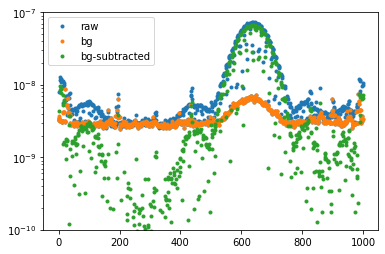

In [1383]:
semilogy(mainbeamconcat.V[14000:15000,900,1],'.',label='raw')
semilogy(mainbeamconcat.V_bg_construct[14000:15000,900,1],'.',label='bg')
semilogy(mainbeamconcat.V_meansub[14000:15000,900,1],'.',label='bg-subtracted')
ylim(1e-10,1e-7)
legend()

[0.0, 0.0, 1.5708, 0.0, 3.0, 0.0]
[0.0, 0.0, 1.5708, 0.0, 3.0, 0.0]
[0.0, 0.0, 1.5708, 0.0, 3.0, 0.0]
[0.0, 0.0, 1.5708, 3.14159, 2.93634, 0.0]
[0.0, 0.0, 1.5708, 0.0, 3.0, 0.0]
[0.0, 0.0, 1.5708, -3.14159, 2.61425, 0.0]
[0.0, 0.0, 1.5708, 0.0, 3.0, 0.0]
[0.0, 0.0, 1.5708, -3.0708, 2.4178, 0.0]
[0.0, 0.0, 1.5708, 0.0, 3.0, 0.0]
[0.0, 0.0, 1.5708, -2.07427, 2.25096, 0.0]
[0.0, 0.0, 1.5708, 0.0, 3.0, 0.0]
[0.0, 0.0, 1.5708, 0.0, 3.0, 0.0]
[0.0, 0.15736, 1.55619, 1.3621, 2.35102, 0.0]
[0.0, 0.0, 1.5708, 0.0, 3.0, 0.0]


/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:45: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:49: UserWarning: Data has no positive values, and therefore cannot be log-scaled.


[0.0, 0.0, 1.5708, 0.0, 3.0, 0.0]
[0.0, 0.0, 1.5708, -2.64748, 2.50402, 0.0]


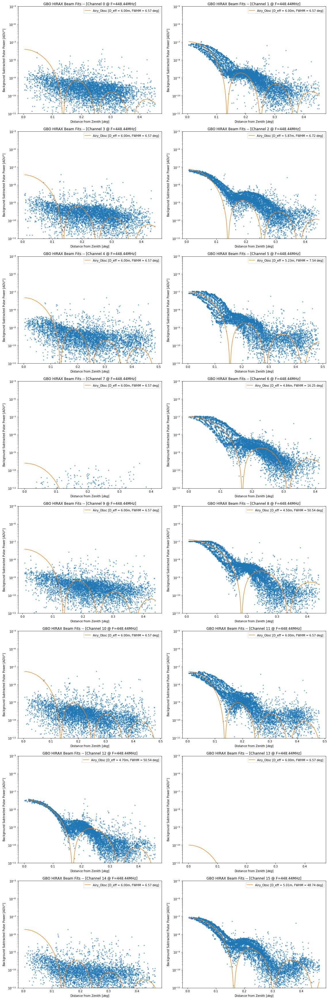

In [1040]:
fig1=figure(figsize=(16,int(6*mainbeamconcat.n_channels)))
for i in range(mainbeamconcat.n_channels):
    ax=fig1.add_subplot(int(mainbeamconcat.n_channels),2,i+1)
    find=900
    tlb,tub=[4125,24000] # Full Grid
    #tlb,tub=[14000,17000]
    #tlb,tub=[13100,13650]
    ## RAW DATA:
    t_inds=mainbeamconcat.t_index[tlb:tub]
    dat0=mainbeamconcat.V[t_inds,find,i]
    
    ## MEANSUB DATA:
    t_inds=np.intersect1d(mainbeamconcat.t_index[tlb:tub],mainbeamconcat.inds_on)
    dat=mainbeamconcat.V_meansub[t_inds,find,i]
    phitheta=mainbeamconcat.drone_rpt_r_per_dish_interp[int(np.floor(i/2)),t_inds,1:]
    
    #Amplitude: 
    a0=np.nanmax(dat)
    abounds=[0.0,np.inf]
    #Epsilon (Obscuration ratio): 
    ep0=0.0
    epbounds=[0.0,0.2]
    #Theta Offset:
    thetaoff0=0.0
    thetaoffbounds=[-np.pi,np.pi]
    #Phi Offset:
    phioff0=np.pi/2.0
    phioffbounds=[-np.pi/2.0,np.pi/2.0]
    #Effective Dish Radius:
    aEff0=3.0
    aEffbounds=[0.0,3.0]
    #Background:
    bg0=0.0
    bgbounds=[0.0,np.inf]
    bgbounds=[0.0,1e-20]
    

    #INPUT PARAMS & Curve Fitting: Obscured Airy 2d
    p0=[a0,ep0,phioff0,thetaoff0,aEff0,bg0]
    pbounds=([abounds[0],epbounds[0],phioffbounds[0],thetaoffbounds[0],aEffbounds[0],bgbounds[0]],\
             [abounds[1],epbounds[1],phioffbounds[1],thetaoffbounds[1],aEffbounds[1],bgbounds[1]])
    popt,pcov=curve_fit(Airy_I_Fit_obs_2d,phitheta,dat,p0=p0,bounds=pbounds,maxfev=10000)
    
    dd=Ang_Dist(phitheta,popt[2],popt[3])
    semilogy(dd,dat,'.',alpha=0.5) 
    
    print([round(k,5) for k in popt])
    phithetasim=np.vstack((np.linspace(np.nanmin(dd),np.nanmax(dd),1000),np.linspace(np.nanmin(dd),np.nanmax(dd),1000))).T
    ax.semilogy(Ang_Dist(phithetasim,popt[2],popt[3]),Airy_I_Fit_obs_2d(phithetasim,*popt),label="Airy_Obsc [D_eff = {:.2f}m, FWHM = {:.2f} deg]".format(2.0*popt[-2],180.0/np.pi*Airy_Return_FWHM(theta,popt)))
    ax.set_ylim(1e-11,1e-5)
    ax.set_title('GBO HIRAX Beam Fits -- [Channel {} @ F={:.2f}MHz]'.format(mainbeamconcat.chmap[i],mainbeamconcat.f_arr[find]))
    ax.set_xlabel('Distance from Zenith [$deg$]')
    ax.set_ylabel('Background Subtracted Pulse Power [$ADU^2$]')
    ax.legend(loc=1)
tight_layout()

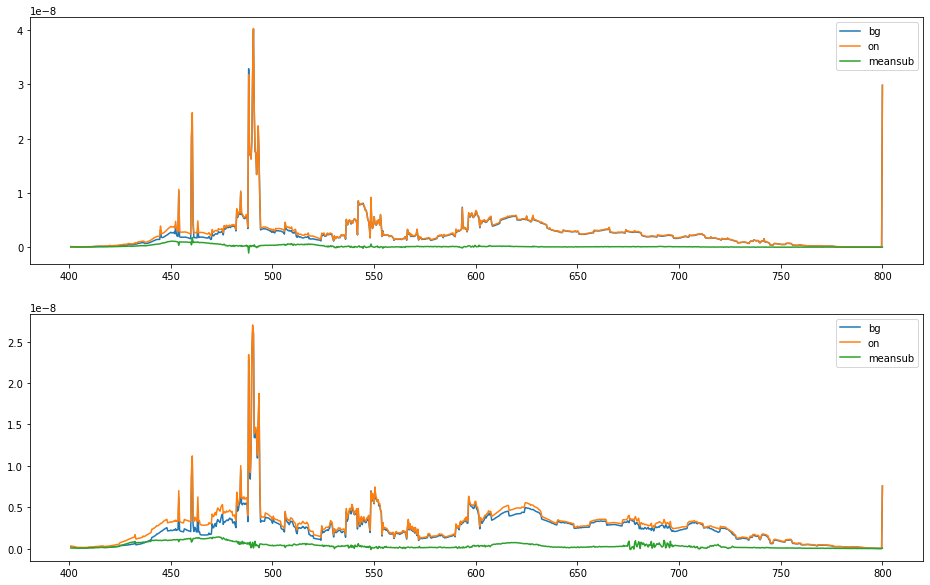

In [362]:
fig1,[ax1,ax2]=subplots(nrows=2,ncols=1,figsize=(16,10))
t0,t1=[1580,1590]
t0,t1=[1540,1560]
for i,ax in enumerate([ax1,ax2]):
    ax.plot(pulsedgridconcat.f_arr,np.nanmean(pulsedgridconcat.pulse_V_bg[t0:t1,:,2*i],axis=0),label="bg")
    ax.plot(pulsedgridconcat.f_arr,np.nanmean(pulsedgridconcat.pulse_V_on[t0:t1,:,2*i],axis=0),label="on")
    ax.plot(pulsedgridconcat.f_arr,np.nanmean(pulsedgridconcat.pulse_V_meansub[t0:t1,:,2*i],axis=0),label="meansub")
    ax.legend()

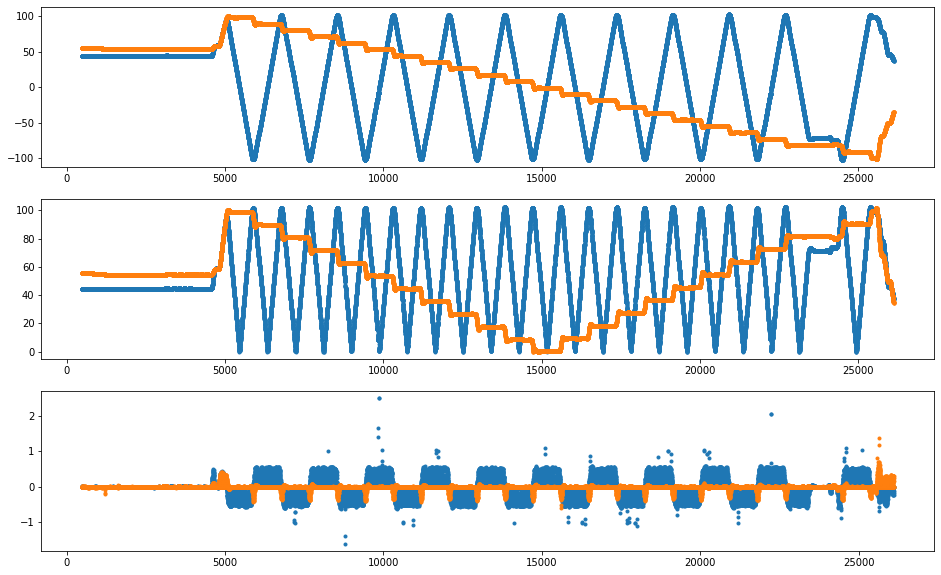

In [177]:
fig1,[ax1,ax2,ax3]=subplots(nrows=3,ncols=1,figsize=(16,10))
ax1.plot(pulsedgridconcat.t_index,pulsedgridconcat.drone_xyz_LC_interp[:,0],'.')
ax1.plot(pulsedgridconcat.t_index,pulsedgridconcat.drone_xyz_LC_interp[:,1],'.')


ax2.plot(pulsedgridconcat.t_index,np.abs(pulsedgridconcat.drone_xyz_LC_interp[:,0]),'.')
ax2.plot(pulsedgridconcat.t_index,np.abs(pulsedgridconcat.drone_xyz_LC_interp[:,1]),'.')

ax3.plot(pulsedgridconcat.t_index[:-1],np.diff(pulsedgridconcat.drone_xyz_LC_interp[:,0]),'.')
ax3.plot(pulsedgridconcat.t_index[:-1],np.diff(pulsedgridconcat.drone_xyz_LC_interp[:,1]),'.')

#xx=np.where(np.diff(np.sign(np.diff(pulsedgridconcat.drone_xyz_LC_interp[:,0]))))[0]

#for ax in [ax1,ax2,ax3]:
#    ax.set_xlim(5000,10000)



ValueError: array must not contain infs or NaNs

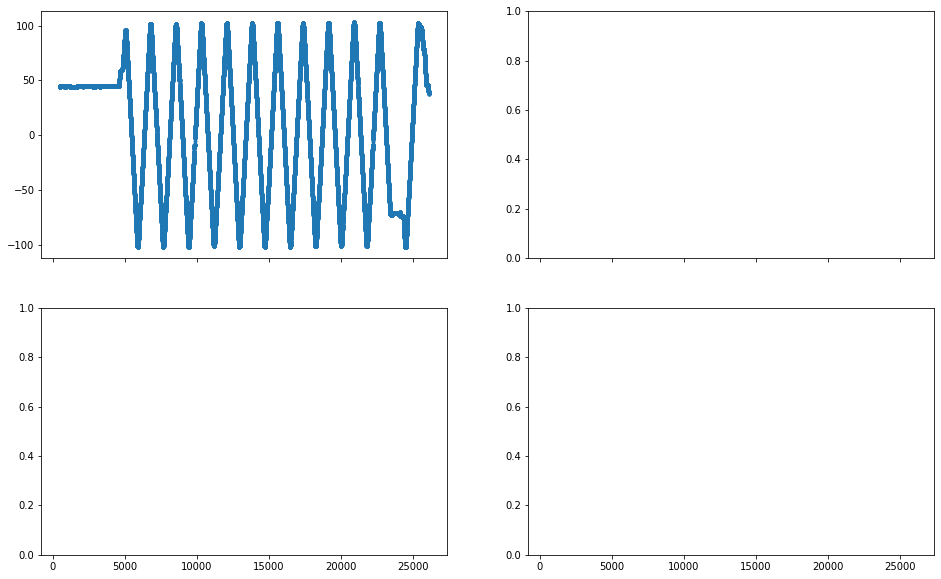

In [598]:
t=pulsedgridconcat.t_index
x=pulsedgridconcat.drone_xyz_LC_interp[:,0]
y=pulsedgridconcat.drone_xyz_LC_interp[:,1]
z=pulsedgridconcat.drone_xyz_LC_interp[:,2]

tlb,tub=[5000,23000]
tlb,tub=[0,-1]
fig1,[[ax1,ax2],[ax3,ax4]]=subplots(nrows=2,ncols=2,figsize=(16,10),sharex=True)
ax1.plot(t[tlb:tub],x[tlb:tub],'.')

a0=100.0
f0=(2*np.pi)*(8.5/15000)
phi0=np.pi/2.0
bg0=0
p0=[a0,f0,phi0,bg0]

## X
popt,pcov=curve_fit(my_sin,t[tlb:tub],x[tlb:tub],p0=p0)
print(popt)
ax1.plot(t[tlb:tub],my_sin(t[tlb:tub],*popt),'.')

ax3.plot(t[tlb:tub-1],np.diff(x[tlb:tub]),'.')
popt,pcov=curve_fit(my_sin,t[tlb:tub-1],np.diff(x[tlb:tub]),p0=p0)
print(popt)
ax3.plot(t[tlb:tub-1],my_sin(t[tlb:tub-1],*popt),'.')
ax3.set_ylim(-1,1)

## Y

ax2.plot(t[tlb:tub],y[tlb:tub],'.')
popt,pcov=curve_fit(my_sin,t[tlb:tub],y[tlb:tub],p0=p0)
print(popt)
ax2.plot(t[tlb:tub],my_sin(t[tlb:tub],*popt),'.')

ax4.plot(t[tlb:tub-1],np.diff(y[tlb:tub]),'.')
popt,pcov=curve_fit(my_sin,t[tlb:tub-1],np.diff(y[tlb:tub]),p0=p0)
print(popt)
ax4.plot(t[tlb:tub-1],my_sin(t[tlb:tub-1],*popt),'.')
ax4.set_ylim(-1,1)






Minima: [-77.77777778 -68.56856857 -59.55955956 -50.15015015 -41.34134134
 -32.33233233 -23.32332332 -14.31431431  -5.10510511   3.7037037
  12.71271271  21.72172172  30.93093093  39.93993994  48.94894895
  57.95795796  66.76676677  75.77577578  84.78478478  93.99399399]
Maxima: [-81.78178178 -72.57257257 -63.56356356 -54.55455455 -45.54554555
 -36.53653654 -27.52752753 -18.51851852  -9.50950951  -0.3003003
   8.50850851  17.71771772  26.72672673  35.73573574  44.74474474
  53.75375375  62.76276276  71.77177177  80.78078078  89.78978979
  98.7987988 ]
Minima: [-77.71771772 -68.46846847 -59.42942943 -50.18018018 -41.35135135
 -32.31231231 -23.27327327 -14.23423423  -5.1951952    3.84384384
  12.67267267  21.71171171  30.96096096  40.          48.82882883
  57.86786787  66.90690691  75.94594595  84.77477477  93.81381381]
Maxima: [-81.71171171 -72.67267267 -63.63363363 -54.59459459 -45.55555556
 -36.51651652 -27.47747748 -18.43843844  -9.3993994   -0.36036036
   8.67867868  17.71771772  2

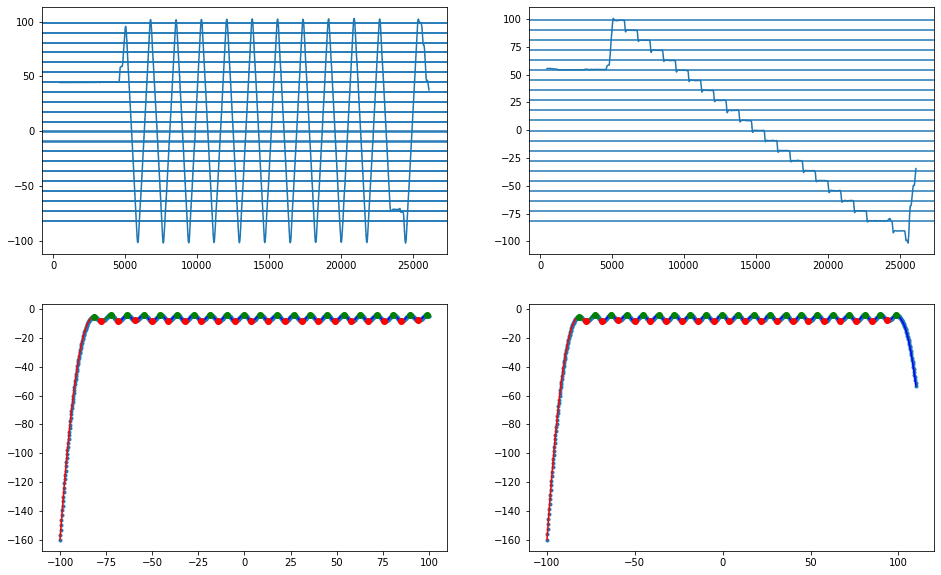

In [368]:
fig1,[[ax1,ax2],[ax3,ax4]]=subplots(nrows=2,ncols=2,figsize=(16,10))
ax1.plot(t,x)
ax2.plot(t,y)
#ax3.plot(t,z)

from sklearn.neighbors.kde import KernelDensity

xtry=y[tlb:tub].reshape(-1, 1)
kde=KernelDensity(kernel='gaussian', bandwidth=1).fit(xtry)
s=np.linspace(-100,100,1000)
e=kde.score_samples(s.reshape(-1,1))
ax3.plot(s,e,'.')

mi, ma = argrelextrema(e, np.less)[0], argrelextrema(e, np.greater)[0]

print("Minima:", s[mi])
print("Maxima:", s[ma])

ax3.plot(s[:mi[0]+1], e[:mi[0]+1], 'r',
     s[mi[0]:mi[1]+1], e[mi[0]:mi[1]+1], 'g',
     s[mi[1]:], e[mi[1]:], 'b',
     s[ma], e[ma], 'go',
     s[mi], e[mi], 'ro')

for i,zz in enumerate(ma):
    ax1.axhline(s[zz])

xtry=y[tlb:tub].reshape(-1, 1)
kde=KernelDensity(kernel='gaussian', bandwidth=1).fit(xtry)
s=np.linspace(-100,110,1000)
e=kde.score_samples(s.reshape(-1,1))
ax4.plot(s,e,'.')

mi, ma = argrelextrema(e, np.less)[0], argrelextrema(e, np.greater)[0]

print("Minima:", s[mi])
print("Maxima:", s[ma])

ax4.plot(s[:mi[0]+1], e[:mi[0]+1], 'r',
     s[mi[0]:mi[1]+1], e[mi[0]:mi[1]+1], 'g',
     s[mi[1]:], e[mi[1]:], 'b',
     s[ma], e[ma], 'go',
     s[mi], e[mi], 'ro')

for i,zz in enumerate(ma):
    ax1.axhline(s[zz])
    ax2.axhline(s[zz])


In [331]:

print(a[a < mi[0]], a[(a >= mi[0]) * (a <= mi[1])], a[a >= mi[1]])

[ 55.40976356  55.40976356  55.40937065 ... -34.58653179 -34.58653179
 -34.58653179] [] []


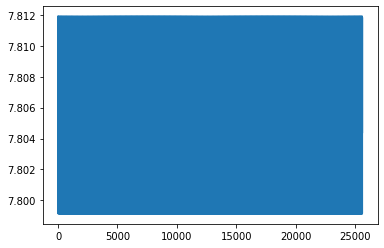

In [244]:
# create the function we want to fit
def my_sin(t, a,f,phi,bg):
    return a*np.sin((f*t)+phi)+bg


a0=100
f0=100
phi0=0
bg0=0
p0=[a0,f0,phi0,bg0]

# now do the fit
popt,pcov= curve_fit(my_sin, t[500:], x[500:], p0=p0)
plot(my_sin(t[500:],*popt))

In [1330]:
## Thursday 200m Pulsed Grid Flight w/ 8 Channels / 4 Dishes:

## Initialize correlator data class and pull auto correlations:
gaindir='/hirax/GBO_Data/TONE_ACQ/digital_gains/20210826T185621Z_yale_drone_yale_digitalgain/'
datadir='/hirax/GBO_Data/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/'
pulsedgrid200m_corr=Corr_Data(n_channels=8,\
                              chmap=GBO8_chmap,\
                              Data_Directory=datadir,\
                              Working_Directory=workingdir,\
                              Gain_Directory=gaindir)

## Read Drone Data: 
drone_directory='/hirax/all_drone_data/datcon_csv/'
ndishes=4
pulsedgrid200m_drone=Drone_Data(dronedir=drone_directory,\
                                FLYTAG='FLY534.csv',\
                                Origin_llh=GBO_HIRAX_DISH_0,\
                                Origin_key='Hirax_Dish_0',\
                                dkeys=Array_Keys[:ndishes],\
                                dcoords=Array_Coords[:ndishes],\
                                dpointings=Array_Pointings[:ndishes],\
                                dpols=Array_Pols[:ndishes])

Initializing Correlator Class using:
 --> /hirax/GBO_Data/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> Arrays initialized with shape (97, 256, 1023, 8)
Assigning array values by reading in data files:
 --> Loading File: 0096/0096Initializing drone data via datcon_csv routine: FLY534.csv
Interpolating time starting at 2021-08-26T18:56:23Z
generating llh, geocentric cartesian, local cartesian, and local spherical coordinates.
generating dish and receiver line of sight coordinates.


Initializing CONCAT CLASS using:
 --> /hirax/GBO_Data/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv


/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:43: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:44: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future


Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Maximum Pearson_R Correlations:
  --> t_indices = [450. 449. 448. 448. 454. 448. 451. 451.]
  --> t_offsets = [-0.21981982 -0.22022022 -0.22062062 -0.22062062 -0.21821822 -0.22062062
 -0.21941942 -0.21941942]
Selecting global time offset:
  --> global_t_offset = -0.1990200200
Finding relevant pulsing indices and checking for overlaps:
  --> on/off ind intersection: []
  --> on/span ind intersection: []
  --> off/span ind intersection: []


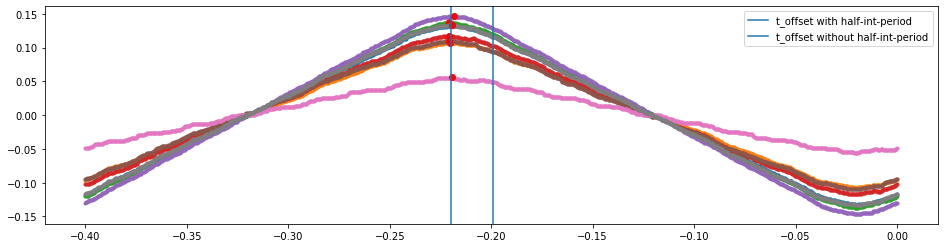

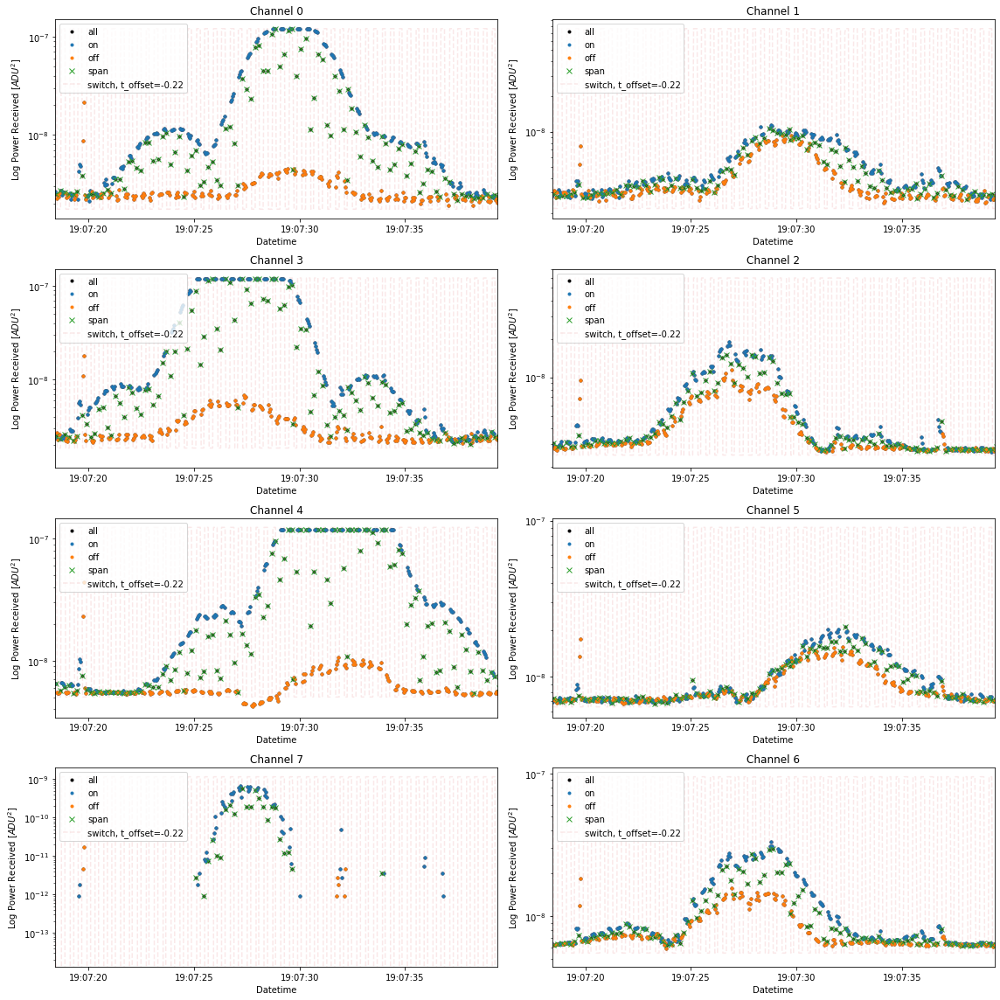

In [1331]:
## Initialize CONCAT class and interpolate drone coords:
pulsedgridconcat=CONCAT(CORRDATCLASS=pulsedgrid200m_corr,DRONEDATCLASS=pulsedgrid200m_drone)

## Find the pulsed source signal: (comment out if source was broadcast continuously)
pulsedgridconcat.Extract_Source_Pulses(Period=0.4e6,\
                                       Dutycycle=0.2e6,\
                                       t_bounds=[15400,15900],\
                                       f_ind=[900],\
                                       half_int_period=0.021)

## Create pulse-averaged visibility matrices: on, off, background subtracted:
pulsedgridconcat.Perform_Background_Subtraction()

In [1332]:
pulsedgridconcat.Plot_Beammap_LC(t_bounds=[3750,24100],\
                                 f_bounds=[900,910],\
                                 pulse_args="meanspec_meansub",\
                                 cbounds=[1e-11,1e-7],\
                                 dotsize=40)

AttributeError: 'CONCAT' object has no attribute 'pulse_t_ind'

<Figure size 1152x2304 with 0 Axes>

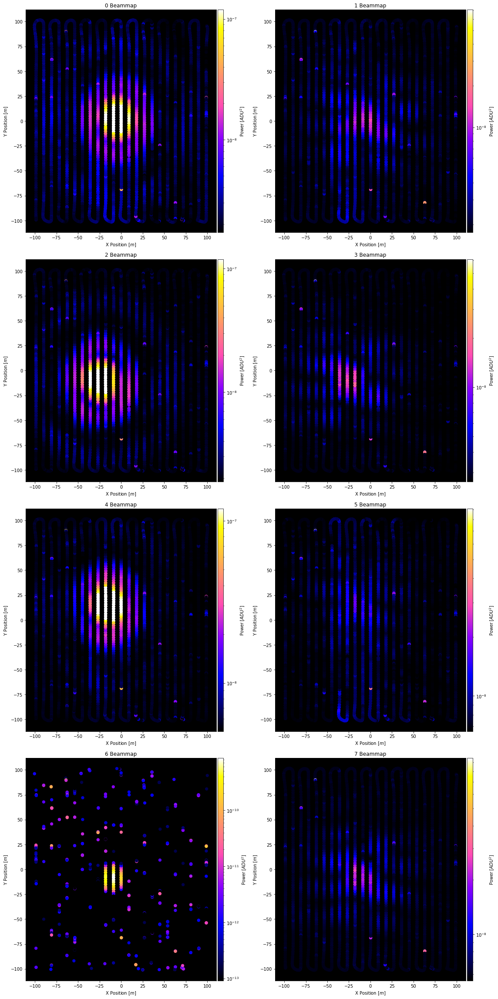

In [1333]:
fig1=figure(figsize=(16,int(8*pulsedgridconcat.n_channels/2)))
for i in range(pulsedgridconcat.n_channels):
    t_bounds=[3750,24100]
    f_bounds=[900,910]
    dotsize=40
    inds_on_cut=np.intersect1d(np.arange(t_bounds[0],t_bounds[1]),pulsedgridconcat.inds_on).tolist()
    ax=fig1.add_subplot(int(pulsedgridconcat.n_channels/2),2,i+1)
    ax.set_facecolor('k')
    ax.set_title('{} Beammap'.format(i))
    ax.set_xlabel('X Position $[m]$')
    ax.set_ylabel('Y Position $[m]$')
    im=ax.scatter(pulsedgridconcat.drone_xyz_LC_interp[inds_on_cut,0],pulsedgridconcat.drone_xyz_LC_interp[inds_on_cut,1],s=dotsize,c=np.nanmean(pulsedgridconcat.V[inds_on_cut,f_bounds[0]:f_bounds[1],i],axis=1), cmap='gnuplot2',norm=LogNorm())
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig1.colorbar(im,cax=cax)
    cbar.set_label('Power [$ADU^2$]')
tight_layout()

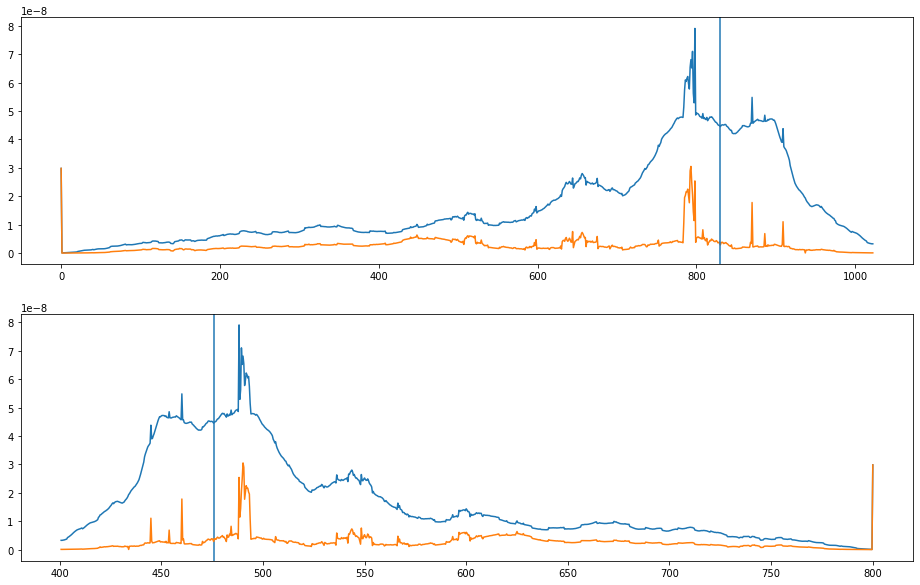

In [1334]:
#np.intersect1d(np.arange(15500,15800),inds_on).tolist()
fig1,[ax1,ax2]=subplots(nrows=2,ncols=1,figsize=(16,10))
ax1.plot(np.nanmean(pulsedgridconcat.V[np.intersect1d(np.arange(15500,15800),pulsedgridconcat.inds_on).tolist(),:,0],axis=0))
ax1.plot(np.nanmean(pulsedgridconcat.V[np.intersect1d(np.arange(15500,15800),pulsedgridconcat.inds_off).tolist(),:,0],axis=0))
ax1.axvline(830)
ax2.axvline(pulsedgridconcat.f_arr[830])
ax2.plot(pulsedgridconcat.f_arr,np.nanmean(pulsedgridconcat.V[np.intersect1d(np.arange(15500,15800),pulsedgridconcat.inds_on).tolist(),:,0],axis=0))
ax2.plot(pulsedgridconcat.f_arr,np.nanmean(pulsedgridconcat.V[np.intersect1d(np.arange(15500,15800),pulsedgridconcat.inds_off).tolist(),:,0],axis=0))

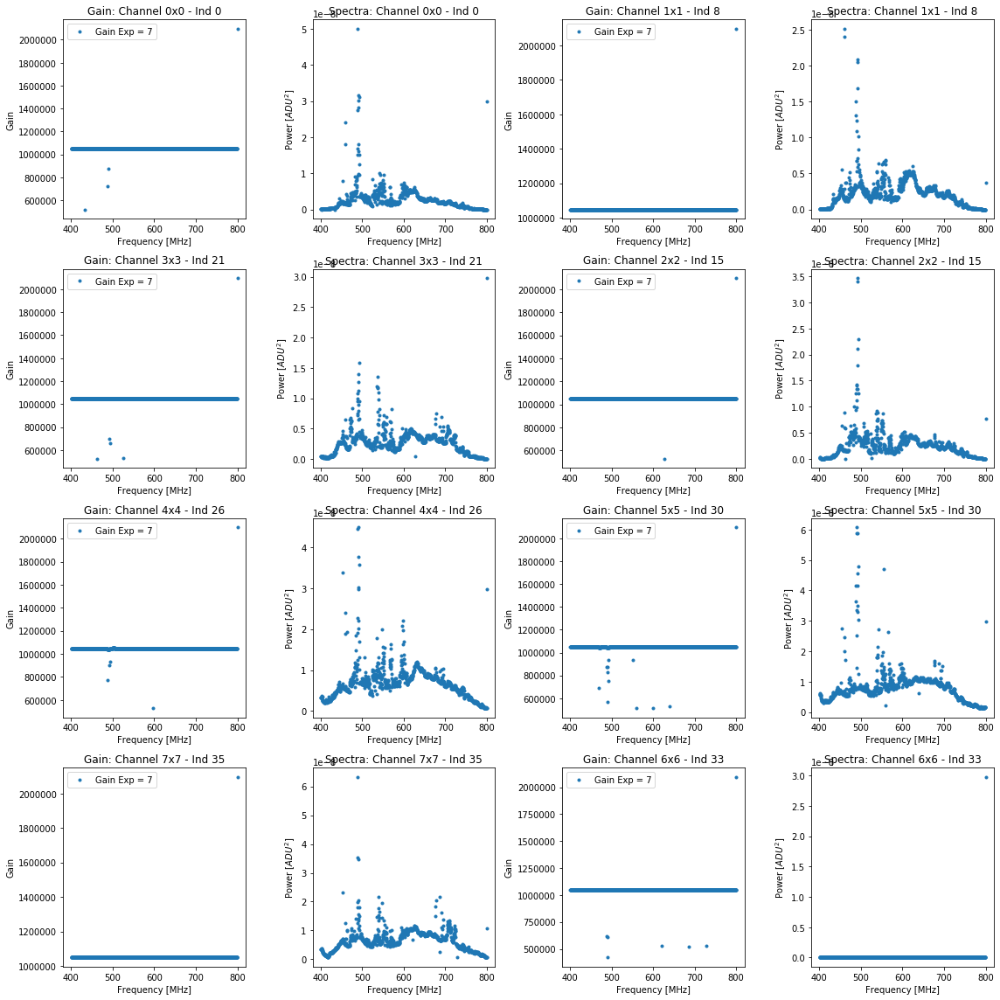

In [1335]:
pulsedgrid200m_corr.Plot_Gains_vs_Data()

In [1336]:
## BACKGROUND SUBTRACTED SPECTRA: ##
    # we want to mean-subtract the on spectra by subtracting off the average before and after spectra
    # if we have N "on" spectra, we need to select N+1 "off" spectra for the before/after arrays
    # let's construct this using the inds_on, inds_off, and inds_span spectra:

## Find the first and last off pulse, and select the span indices between these indices (in inds_span):
span_lb=np.where(pulsedgridconcat.inds_span>pulsedgridconcat.inds_off[0])[0][0]
span_ub=np.where(pulsedgridconcat.inds_span<pulsedgridconcat.inds_off[-1])[0][-1]
bin_indices=np.append(np.append(pulsedgridconcat.inds_off[0],pulsedgridconcat.inds_span[span_lb:span_ub+1]),pulsedgridconcat.inds_off[-1])
## inititalize and loop to create lists of on/off pulse indices for averaging:
meansub_on_inds=[]
meansub_off_inds=[]

## Now loop over the span indices we've created above to extract groups of on and off indices (in t_index):
for j,ind in enumerate(bin_indices[:-1]):
    if int(bin_indices[j]+1) in pulsedgridconcat.inds_on:
        indcut=np.intersect1d(pulsedgridconcat.t_index[bin_indices[j]:bin_indices[j+1]],pulsedgridconcat.inds_on).tolist()
        if len(indcut)>0:
            meansub_on_inds.append(indcut)
    elif int(bin_indices[j]+1) in pulsedgridconcat.inds_off:
        indcut=np.intersect1d(pulsedgridconcat.t_index[bin_indices[j]:bin_indices[j+1]],pulsedgridconcat.inds_off).tolist()
        if len(indcut)>0:
            meansub_off_inds.append(indcut)
            
## initialize averaged arrays for t with dimension n_on and V with dimensions n_on,f,t 
n_on_pulses=len(meansub_on_inds)
pulse_t_ind=np.zeros(n_on_pulses).astype(int)
pulse_V_meansub=np.zeros((n_on_pulses,len(pulsedgridconcat.f_arr),pulsedgridconcat.n_channels))
pulse_V_on=np.zeros((n_on_pulses,len(pulsedgridconcat.f_arr),pulsedgridconcat.n_channels))
pulse_V_bg=np.zeros((n_on_pulses,len(pulsedgridconcat.f_arr),pulsedgridconcat.n_channels))

## Loop over the indices (in inds_span) we've created and populate the t and V_meansub arrays:
for k,indlist in enumerate(meansub_on_inds):
    meanspec_off_L=np.nanmean(pulsedgridconcat.V[meansub_off_inds[k],:,:],axis=0)
    meanspec_off_R=np.nanmean(pulsedgridconcat.V[meansub_off_inds[k+1],:,:],axis=0)
    meanbgs=0.5*(meanspec_off_L+meanspec_off_R)
    pulse_V_meansub[k]=np.nanmean(pulsedgridconcat.V[meansub_on_inds[k],:,:],axis=0)-meanbgs
    pulse_V_on[k]=np.nanmean(pulsedgridconcat.V[meansub_on_inds[k],:,:],axis=0)
    pulse_V_bg[k]=meanbgs
    pulse_t_ind[k]=indlist[0]


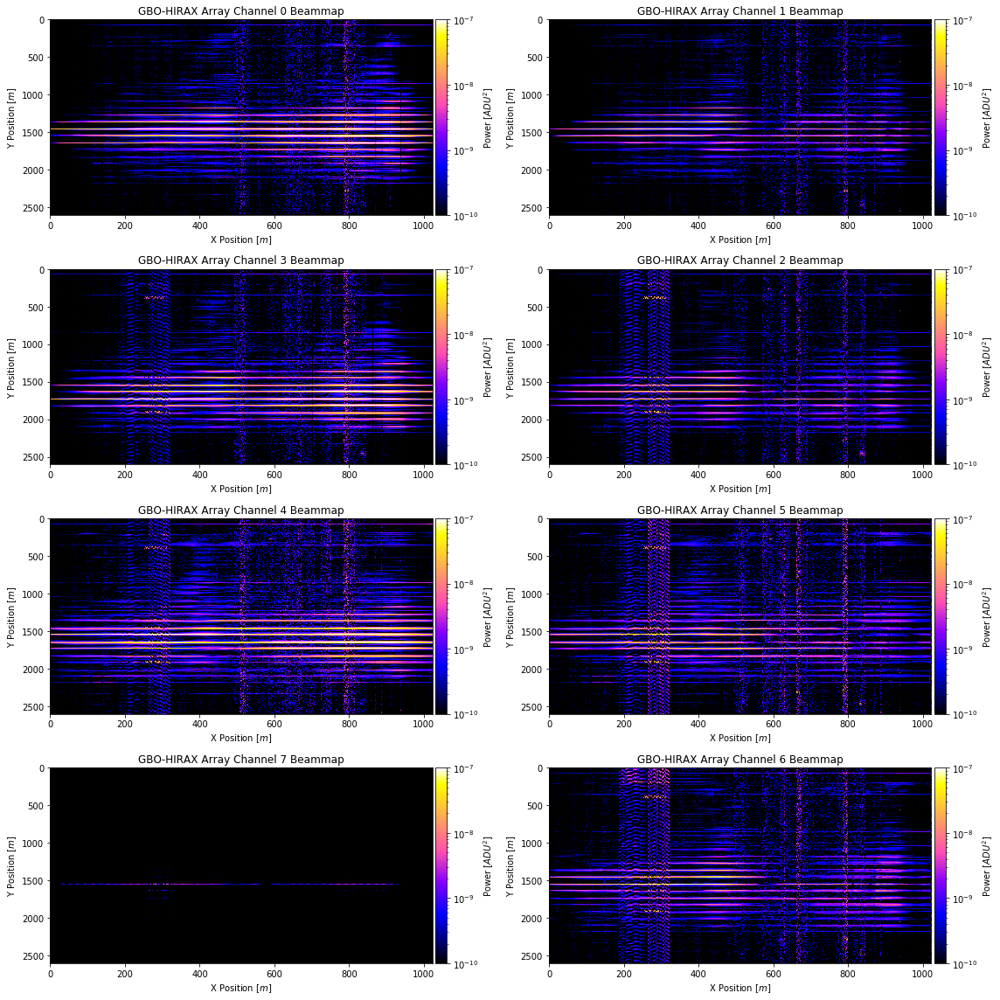

In [1337]:
fig1=figure(figsize=(16,int(4*pulsedgridconcat.n_channels/2)))
for i in range(int(pulsedgridconcat.n_channels)):
    ax=fig1.add_subplot(int(pulsedgridconcat.n_channels/2),2,i+1)
    im=imshow(pulse_V_meansub[:,:,i]*(pulse_V_meansub[:,:,i]>0),aspect="auto",cmap='gnuplot2',norm=LogNorm(vmin=1e-12))
    ax.set_facecolor('k')
    ax.set_title('GBO-HIRAX Array Channel {} Beammap'.format(pulsedgridconcat.chmap[i]))
    ax.set_xlabel('X Position $[m]$')
    ax.set_ylabel('Y Position $[m]$')
    divider=make_axes_locatable(ax)
    im.set_clim(1e-10,1e-7)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=fig1.colorbar(im,cax=cax)
    cbar.set_label('Power [$ADU^2$]')
tight_layout()


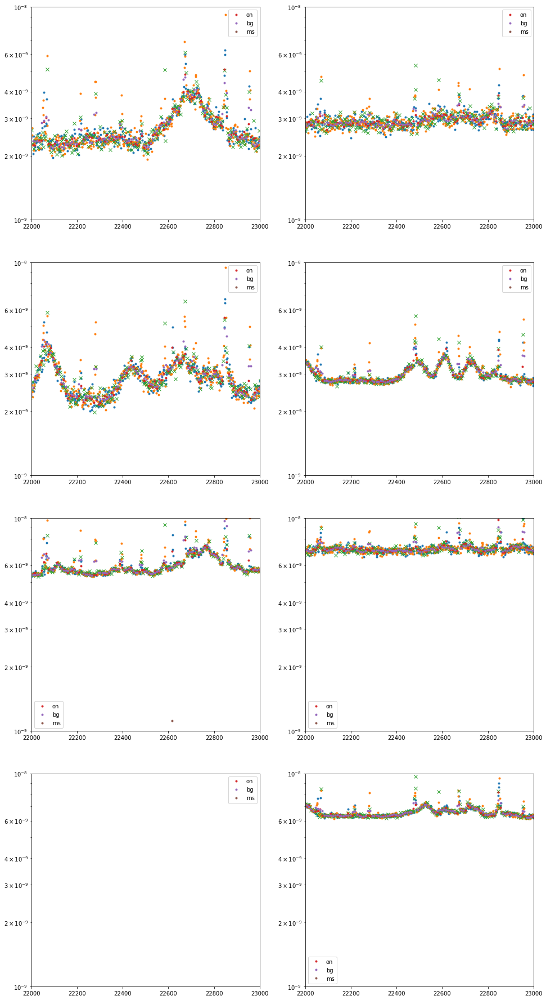

In [1338]:
fig1=figure(figsize=(16,int(8*pulsedgridconcat.n_channels/2)))
for i in range(int(pulsedgridconcat.n_channels)):
    find=900
    ax=fig1.add_subplot(int(pulsedgridconcat.n_channels/2),2,i+1)
    
    ax.semilogy(pulsedgridconcat.t_index[pulsedgridconcat.inds_on],pulsedgridconcat.V[pulsedgridconcat.inds_on,find,i],'.')
    ax.semilogy(pulsedgridconcat.t_index[pulsedgridconcat.inds_off],pulsedgridconcat.V[pulsedgridconcat.inds_off,find,i],'.')
    ax.semilogy(pulsedgridconcat.t_index[pulsedgridconcat.inds_span],pulsedgridconcat.V[pulsedgridconcat.inds_span,find,i],'x')
    ax.semilogy(pulse_t_ind[2000:],pulse_V_on[2000:,find,i],'.',label="on")
    ax.semilogy(pulse_t_ind[2000:],pulse_V_bg[2000:,find,i],'.',label="bg")
    ax.semilogy(pulse_t_ind[2000:],pulse_V_meansub[2000:,find,i],'.',label="ms")
    ax.legend()
    ax.set_xlim(22000,23000)
    ax.set_ylim(1e-9,1e-8)


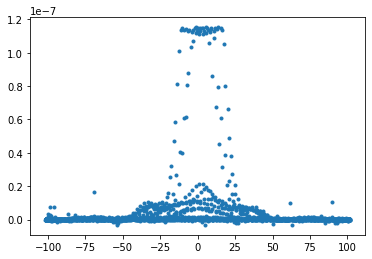

In [1341]:
plot(pulsedgridconcat.drone_xyz_LC_interp[inds_on_cut,1],pulse_V_meansub[pulsebds[0]:pulsebds[1],900,0],'.')

In [1342]:
pulsedgridconcat.t_arr_datetime[20000]

datetime.datetime(2021, 8, 26, 19, 10, 31, 349512, tzinfo=<UTC>)

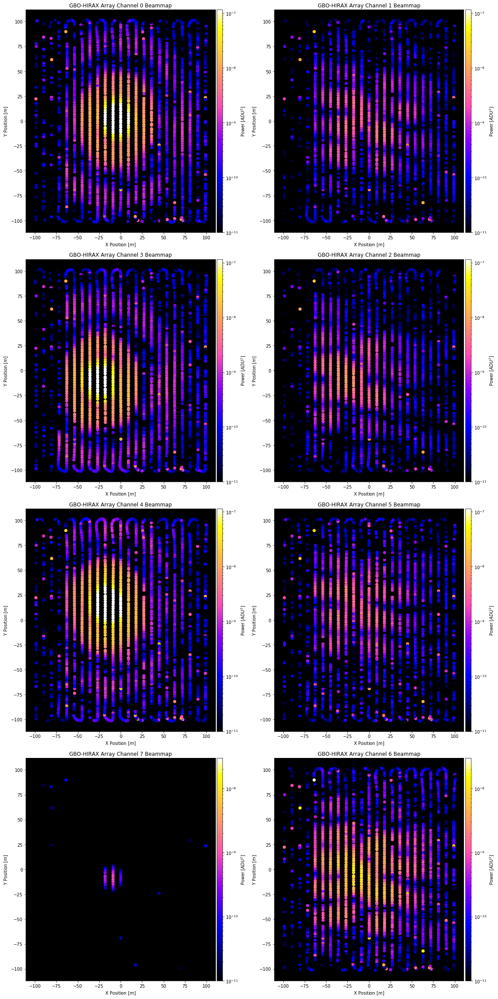

In [1343]:
fig1=figure(figsize=(16,int(8*pulsedgridconcat.n_channels/2)))
for i in range(int(pulsedgridconcat.n_channels/2)):
    t_bounds=[3750,24100]
    f_bounds=[900,910]
    #f_bounds=[600,610]
    dotsize=40
    inds_on_cut=np.intersect1d(np.arange(t_bounds[0],t_bounds[1]),pulse_t_ind).tolist()
    pulsebds=[np.where(inds_on_cut[0]==pulse_t_ind)[0][0],np.where(inds_on_cut[-1]==pulse_t_ind)[0][0]+1]
    ax1=fig1.add_subplot(int(pulsedgridconcat.n_channels/2),2,int(2*i)+1)
    ax2=fig1.add_subplot(int(pulsedgridconcat.n_channels/2),2,int(2*i)+2)
    im1=ax1.scatter(pulsedgridconcat.drone_xyz_LC_interp[inds_on_cut,0],pulsedgridconcat.drone_xyz_LC_interp[inds_on_cut,1],s=dotsize,c=np.nanmean(pulse_V_meansub[pulsebds[0]:pulsebds[1],f_bounds[0]:f_bounds[1],int(2*i)],axis=1),cmap='gnuplot2',norm=LogNorm())
    im2=ax2.scatter(pulsedgridconcat.drone_xyz_LC_interp[inds_on_cut,0],pulsedgridconcat.drone_xyz_LC_interp[inds_on_cut,1],s=dotsize,c=np.nanmean(pulse_V_meansub[pulsebds[0]:pulsebds[1],f_bounds[0]:f_bounds[1],int(2*i)+1],axis=1),cmap='gnuplot2',norm=LogNorm())
    images=[im1,im2]
    for im in images:
        mincl=np.nanmin([im1.get_clim()[0],im2.get_clim()[0]])
        maxcl=np.nanmax([im1.get_clim()[1],im2.get_clim()[1]])
        im.set_clim(1e-11,maxcl)
    for j,ax in enumerate([ax1,ax2]):
        ax.set_facecolor('k')
        ax.set_title('GBO-HIRAX Array Channel {} Beammap'.format(pulsedgridconcat.chmap[int(2*i)+j]))
        ax.set_xlabel('X Position $[m]$')
        ax.set_ylabel('Y Position $[m]$')
        divider=make_axes_locatable(ax)
        cax=divider.append_axes("right", size="3%", pad=0.05)
        cbar=fig1.colorbar(images[j],cax=cax)
        cbar.set_label('Power [$ADU^2$]')
tight_layout()

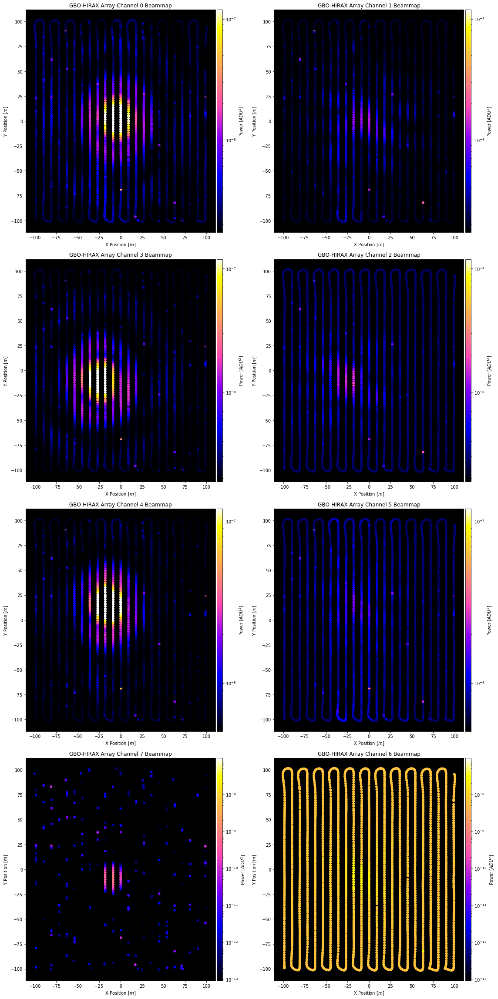

In [1344]:
fig1=figure(figsize=(16,int(8*pulsedgridconcat.n_channels/2)))
for i in range(int(pulsedgridconcat.n_channels/2)):
    t_bounds=[3750,24100]
    f_bounds=[900,910]
    dotsize=20
    inds_on_cut=np.intersect1d(np.arange(t_bounds[0],t_bounds[1]),pulsedgridconcat.inds_on).tolist()
    ax1=fig1.add_subplot(int(pulsedgridconcat.n_channels/2),2,int(2*i)+1)
    ax2=fig1.add_subplot(int(pulsedgridconcat.n_channels/2),2,int(2*i)+2)
    im1=ax1.scatter(pulsedgridconcat.drone_xyz_LC_interp[inds_on_cut,0],pulsedgridconcat.drone_xyz_LC_interp[inds_on_cut,1],s=dotsize,c=np.nanmean(pulsedgridconcat.V[inds_on_cut,f_bounds[0]:f_bounds[1],int(2*i)],axis=1), cmap='gnuplot2',norm=LogNorm())
    im2=ax2.scatter(pulsedgridconcat.drone_xyz_LC_interp[inds_on_cut,0],pulsedgridconcat.drone_xyz_LC_interp[inds_on_cut,1],s=dotsize,c=np.nanmean(pulsedgridconcat.V[inds_on_cut,f_bounds[0]:f_bounds[1],int(2*i)+1],axis=1), cmap='gnuplot2',norm=LogNorm())
    images=[im1,im2]
    for im in images:
        mincl=np.nanmin([im1.get_clim()[0],im2.get_clim()[0]])
        maxcl=np.nanmax([im1.get_clim()[1],im2.get_clim()[1]])
        im.set_clim(mincl,maxcl)
    for j,ax in enumerate([ax1,ax2]):
        ax.set_facecolor('k')
        ax.set_title('GBO-HIRAX Array Channel {} Beammap'.format(pulsedgridconcat.chmap[int(2*i)+j]))
        ax.set_xlabel('X Position $[m]$')
        ax.set_ylabel('Y Position $[m]$')
        divider=make_axes_locatable(ax)
        cax=divider.append_axes("right", size="3%", pad=0.05)
        cbar=fig1.colorbar(images[j],cax=cax)
        cbar.set_label('Power [$ADU^2$]')
         
tight_layout()

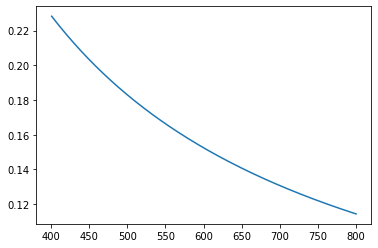

In [1345]:
wavelength_m=(3.0*(10.0**8.0))/(pulsedgridconcat.f_arr*1.0e6)
difflimit=1.22*wavelength_m/4.0
plot(pulsedgridconcat.f_arr,difflimit)

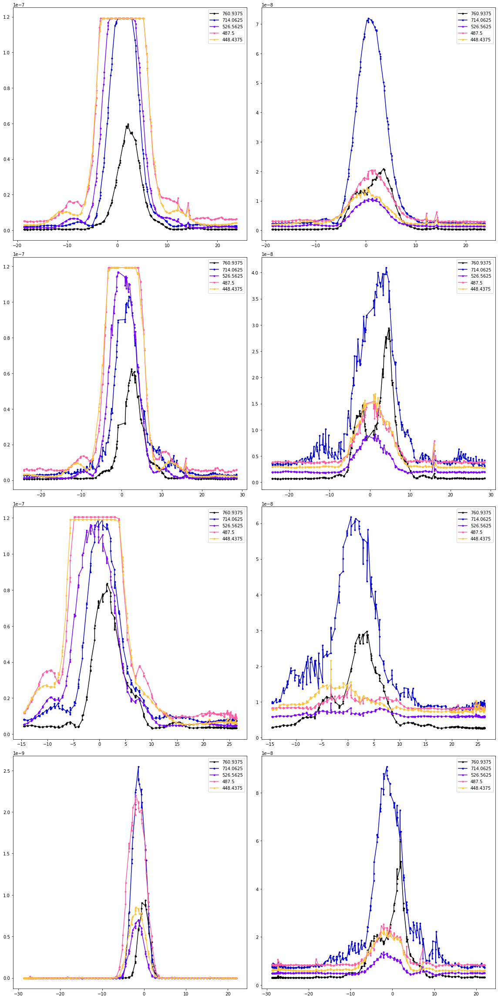

In [1347]:
fig1=figure(figsize=(16,int(8*pulsedgridconcat.n_channels/2)))
for i in range(int(pulsedgridconcat.n_channels/2)):
    #t_bounds=[13650,14200] # just over center in peaking in dish 1
    t_bounds=[[13650,14200],[16200,16900],[14200,14900],[14500,15300]] 
    f_bounds=[600,610] #not sat
    f_bounds=[900,910] #sat
    f_bounds=[900,910]
    dotsize=40
    inds_on_cut=np.intersect1d(np.arange(t_bounds[i][0],t_bounds[i][1]),pulsedgridconcat.inds_on).tolist()
    inds_off_cut=np.intersect1d(np.arange(t_bounds[i][0],t_bounds[i][1]),pulsedgridconcat.inds_off).tolist()
    ax1=fig1.add_subplot(int(pulsedgridconcat.n_channels/2),2,int(2*i+1))
    ax2=fig1.add_subplot(int(pulsedgridconcat.n_channels/2),2,int(2*i+2))
    for k,f_bounds in enumerate([[100,120],[220,240],[700,720],[800,810],[900,910]]):
        ax1.plot(180.0/np.pi*np.sign((np.sin(pulsedgridconcat.drone_rpt_r_per_dish_interp[i,inds_on_cut,1])))*pulsedgridconcat.drone_rpt_r_per_dish_interp[i,inds_on_cut,2],np.nanmean(pulsedgridconcat.V[inds_on_cut,f_bounds[0]:f_bounds[1],int(2*i)],axis=1),'.-',c=colorsarr[int(2*k)],label="{}".format(pulsedgridconcat.f_arr[f_bounds[0]]))
        #ax1.plot(180.0/np.pi*np.sign((np.sin(pulsedgridconcat.drone_rpt_r_per_dish_interp[i,inds_off_cut,1])))*pulsedgridconcat.drone_rpt_r_per_dish_interp[i,inds_off_cut,2],np.nanmean(pulsedgridconcat.V[inds_off_cut,f_bounds[0]:f_bounds[1],int(2*i)],axis=1),'.-',c=colorsarr[int(2*k)])
        #ax.set_facecolor('k')
        #ax.set_title('{} Beammap'.format(i))
        #ax.set_xlabel('X Position $[m]$')
        #ax.set_ylabel('Y Position $[m]$')
        ax2.plot(180.0/np.pi*np.sign((np.sin(pulsedgridconcat.drone_rpt_r_per_dish_interp[i,inds_on_cut,1])))*pulsedgridconcat.drone_rpt_r_per_dish_interp[i,inds_on_cut,2],np.nanmean(pulsedgridconcat.V[inds_on_cut,f_bounds[0]:f_bounds[1],int(2*i)+1],axis=1),'.-',c=colorsarr[int(2*k)],label="{}".format(pulsedgridconcat.f_arr[f_bounds[0]]))
        #ax2.plot(180.0/np.pi*np.sign((np.sin(pulsedgridconcat.drone_rpt_r_per_dish_interp[i,inds_off_cut,1])))*pulsedgridconcat.drone_rpt_r_per_dish_interp[i,inds_off_cut,2],np.nanmean(pulsedgridconcat.V[inds_off_cut,f_bounds[0]:f_bounds[1],int(2*i)+1],axis=1),'.-',c=colorsarr[int(2*k)])
    ax1.legend()
    ax2.legend()
tight_layout()

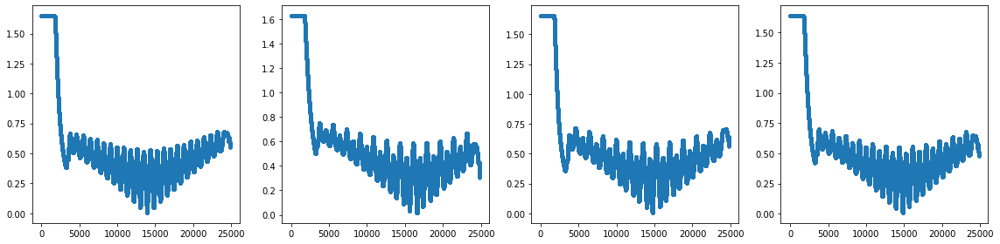

In [1348]:
fig1=figure(figsize=(16,4))
for i in range(int(pulsedgridconcat.n_channels/2)):
    ax=fig1.add_subplot(1,int(pulsedgridconcat.n_channels/2),i+1)
    ax.plot(pulsedgridconcat.drone_rpt_r_per_dish_interp[i,:,2],'.')
tight_layout()

[datetime.timedelta(0) datetime.timedelta(microseconds=1000)
 datetime.timedelta(microseconds=2000)
 datetime.timedelta(microseconds=3000)
 datetime.timedelta(microseconds=4000)
 datetime.timedelta(microseconds=5000)
 datetime.timedelta(microseconds=6000)]


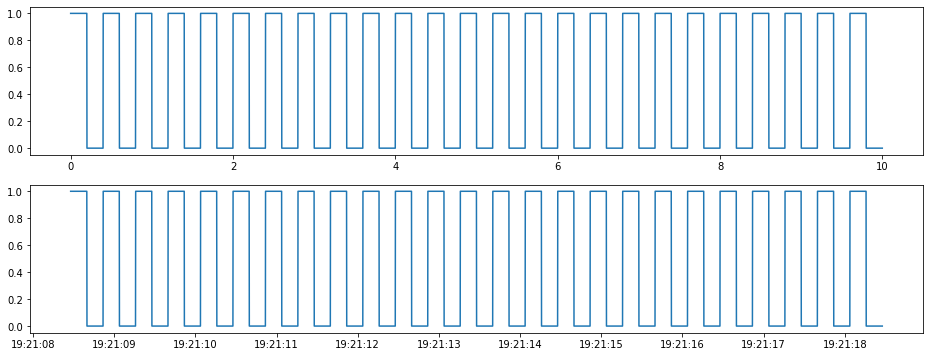

In [18]:
## PULSED DATA FUNCTION: Identifying/Producing pulse indices using the square wave function
    ## Specify the following parameters to produce the waveform:
        # total_duration = full time that the waveform will be produced for in seconds
        # period = period of the waveform in microsec
        # duty_cycle_on = source "on" time in microsec within each period
    ## Square Wave Signal will be on from 0 to 2*pi*duty_cycle_on and off from 2*pi*duty_cycle_on to 2*pi

from scipy.signal import square
from scipy.stats import pearsonr

def Interp_Switch(x,t_full,switch_full):
    return np.interp(x,t_full,switch_full)

def Pulsed_Data_Waveform(total_duration,period,duty_cycle_on):
    ## Outputs should be an array of timedeltas and an array of switch voltages (1s and 0s)
    ## Let's make the time resolution of these arrays milliseconds (10^-3 sec):
    t_steps_ms=int(datetime.timedelta(seconds=total_duration).total_seconds()*1e3)+1 #n_steps
    t_arr_s=np.linspace(0,total_duration,t_steps_ms)
    ## Use the square function from scipy.signal to produce the 1s and 0s:
    switch_signal_arr=0.5*square((2*np.pi/(period*1e-6))*t_arr_s,duty_cycle_on/period)+0.5
    ## Create a timedelta array for interpolation purposes so we can interpolate the square wave later:
    t_arr_datetime=np.array([datetime.timedelta(seconds=timeval) for timeval in t_arr_s])
    return t_arr_s,t_arr_datetime,switch_signal_arr

## Let's assign our input variables:
pperiod=0.4e6  # period in microsec from the flight
pdutycycle=0.2e6 # duty cycle in microsec from the flight
## Duration of the data for which we must generate the switch signal:
concat_duration=int(np.ceil((pulsedgridconcat.t_arr_datetime[-1]-pulsedgridconcat.t_arr_datetime[0]).total_seconds()))

## Use the function and assign some variables:
time_s,time_dt,switch=Pulsed_Data_Waveform(total_duration=concat_duration,period=pperiod,duty_cycle_on=pdutycycle)
## Plot the square wave and print some timedeltas:
fig1,[ax1,ax2]=subplots(nrows=2,ncols=1,figsize=(16,6))
ax1.plot(time_s[0:10000],switch[0:10000])
ax2.plot(time_dt[0:10000]+pulsedgridconcat.t_arr_datetime[0],switch[0:10000])
print(time_dt[0:7])

Maximum Pearson_R Correlation for channel 0 occurs at index 519 with t_offset = -0.1921921922
Maximum Pearson_R Correlation for channel 1 occurs at index 507 with t_offset = -0.1969969970
Maximum Pearson_R Correlation for channel 2 occurs at index 519 with t_offset = -0.1921921922
Maximum Pearson_R Correlation for channel 3 occurs at index 520 with t_offset = -0.1917917918
Maximum Pearson_R Correlation for channel 4 occurs at index 518 with t_offset = -0.1925925926
Maximum Pearson_R Correlation for channel 5 occurs at index 510 with t_offset = -0.1957957958
Maximum Pearson_R Correlation for channel 6 occurs at index 520 with t_offset = -0.1917917918
Maximum Pearson_R Correlation for channel 7 occurs at index 520 with t_offset = -0.1917917918
Maximum Pearson_R Correlation for channel 8 occurs at index 519 with t_offset = -0.1921921922
Maximum Pearson_R Correlation for channel 9 occurs at index 520 with t_offset = -0.1917917918
Maximum Pearson_R Correlation for channel 10 occurs at index

/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in true_divide
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: All-NaN slice encountered


Maximum Pearson_R Correlation for channel 13 occurs at index 519 with t_offset = -0.1921921922
Maximum Pearson_R Correlation for channel 14 occurs at index 518 with t_offset = -0.1925925926
Maximum Pearson_R Correlation for channel 15 occurs at index 509 with t_offset = -0.1961961962


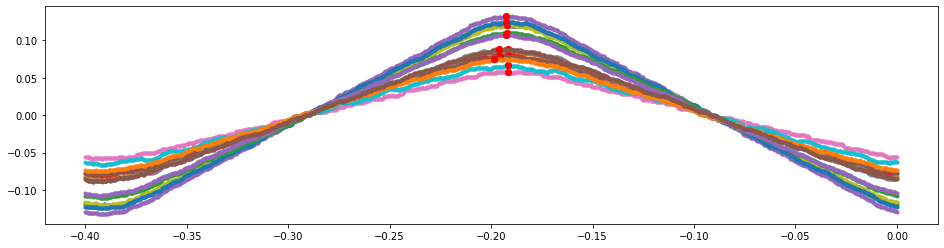

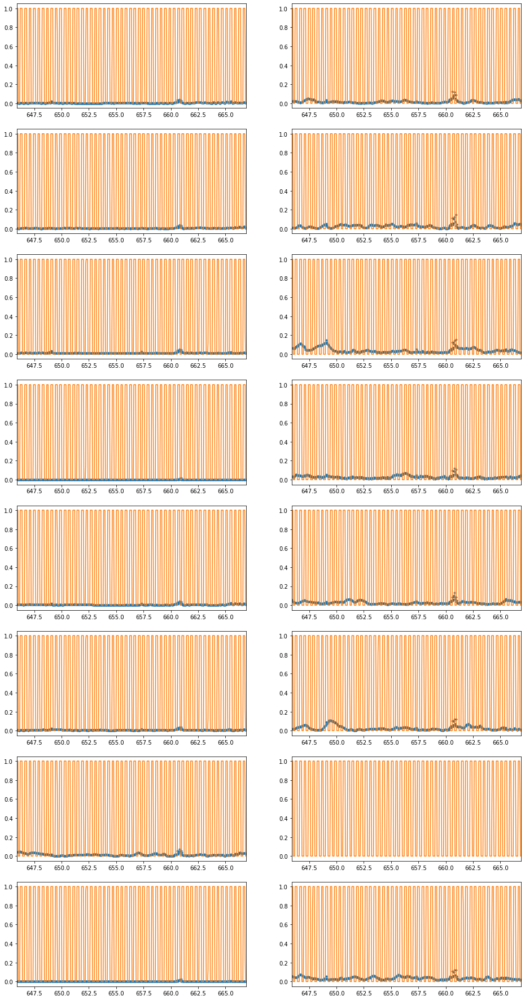

In [25]:
t_offset_dist=np.linspace(-0.4,0.0,1000)
Pr_arr=np.zeros((pulsedgridconcat.n_channels,t_offset_dist.shape[0]))
Pr_max_ind_per_channel=np.zeros(pulsedgridconcat.n_channels)
Pr_max_t_0_per_channel=np.zeros(pulsedgridconcat.n_channels)

cdtlb,cdtub=[15500,15800]
chmap=[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
find=830

## Try finding offset for full range
cdtlb,cdtub=[0,-1]
## Compare to gaussian cut: same t_offset solution found!
cdtlb,cdtub=[15400,15900]

## Loop over channels to find/plot a time offset solution with some clever fitting:
fig1,ax1=subplots(nrows=1,ncols=1,figsize=(16,4))
#fig2,ax3=subplots(nrows=1,ncols=1,figsize=(9,9))
fig2=figure(figsize=(16,int(4*pulsedgridconcat.n_channels/2)))
for i in range(pulsedgridconcat.n_channels):
    ax=fig2.add_subplot(int(pulsedgridconcat.n_channels/2),2,i+1)   
    ## If we use a mean subtracted data cut we can find where power exceeds zero to find signal
    minsubdata=pulsedgridconcat.V[:,find,chmap[i]]-np.nanmin(pulsedgridconcat.V[:,find,chmap[i]],axis=0)
    normminsubdata=minsubdata/np.nanmax(minsubdata)
    t_full=np.array([(m-pulsedgridconcat.t_arr_datetime[0]).total_seconds() for m in pulsedgridconcat.t_arr_datetime[:]])
    ## Plot all of the NORMALIZED, MINIMUM SUBTRACTED data points:
    ax.plot(t_full,normminsubdata,'.',label='mean subtracted data')
    ## Loop over all time offsets in t_offset_dist to find maximum correlation between squarewave and data:
    for j,t_offset in enumerate(t_offset_dist):
        shiftedswitch=Interp_Switch(t_full,time_s+t_offset,switch)
        try:
            Pr_arr[i,j]=pearsonr(normminsubdata.flatten(),shiftedswitch.flatten())[0]
        except ValueError:
            Pr_arr[i,j]=np.NAN    
    ax1.plot(t_offset_dist,Pr_arr[i,:],'.')
    try:
        maxPrind=np.where(Pr_arr[i,:]==np.nanmax(Pr_arr[i,:]))[0][0]
        ax1.plot(t_offset_dist[maxPrind],Pr_arr[i,maxPrind],'ro')
        Pr_max_ind_per_channel[i]=maxPrind
        Pr_max_t_0_per_channel[i]=t_offset_dist[maxPrind]
    except IndexError:
        Pr_max_ind_per_channel[i]=np.NAN
        Pr_max_t_0_per_channel[i]=np.NAN
    print("Maximum Pearson_R Correlation for channel {} occurs at index {} with t_offset = {:.10f}".format(chmap[i],maxPrind,t_offset_dist[maxPrind]))
    ax1.plot(t_offset_dist[maxPrind],Pr_arr[i,maxPrind],'ro')
    ax.plot(t_full,Interp_Switch(t_full,time_s+t_offset_dist[maxPrind],switch),label='mean subtracted data')
    ax.set_xlim(t_full[cdtlb],t_full[cdtub])

In [111]:
t_offset_global=t_offset_dist[int(np.nanmedian(Pr_max_ind_per_channel))]
print("Selecting global time offset of index {} with t_offset = {:.10f}".format(int(np.nanmedian(Pr_max_ind_per_channel)),t_offset_global))

## Interpolate the switching function with the concat timestamps:
t_for_interp_out=np.array([(m-pulsedgridconcat.t_arr_datetime[0]).total_seconds() for m in pulsedgridconcat.t_arr_datetime])
t_for_interp_in=np.array([m.total_seconds() for m in time_dt])
#switch_interp_f=np.interp(t_for_interp_out,t_for_interp_in+t_offset_dist[maxPrind],switch)
switch_interp_f=np.interp(t_for_interp_out,t_for_interp_in+t_offset_global+0.021,switch) # +1/2 int period
## add t_offset and half of a correlator integration period

Selecting global time offset of index 519 with t_offset = -0.1921921922


on/off ind intersection: []
on/span ind intersection: []
off/span ind intersection: []


/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:18: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:19: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:20: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:22: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/home/tyndall/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: UserWarning: Data has no positive values, and therefore cannot be log-scaled.


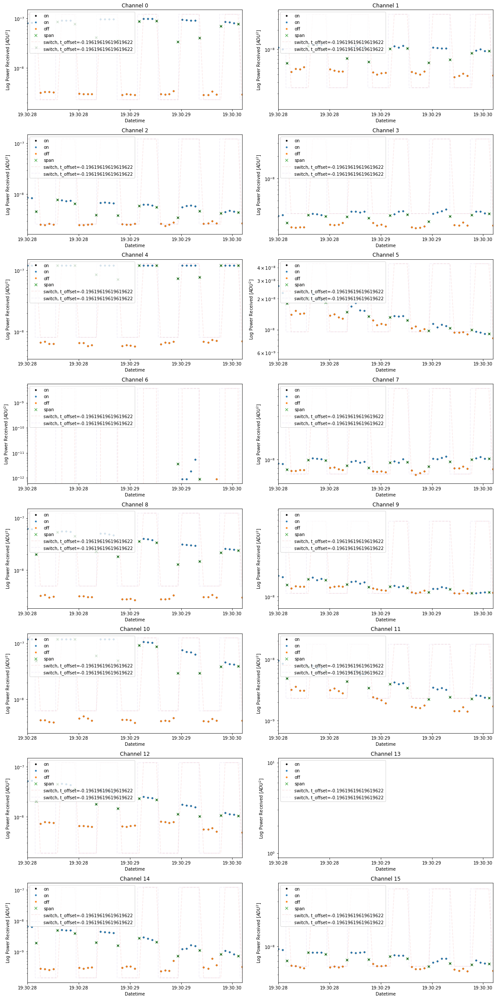

In [112]:
## Once we have our time offset, we must extract indices where the source is on/off/rising:
inds_span=np.union1d(list(set(np.where(np.diff(np.sign(switch_interp_f-0.5)))[0])),\
                     np.intersect1d(np.where(1.0>switch_interp_f),np.where(switch_interp_f>0.0))).tolist()
inds_on=list(set(np.where(switch_interp_f==1.0)[0])-set(inds_span))
inds_off=list(set(np.where(switch_interp_f==0.0)[0])-set(inds_span))
## Each of these lists of indices should also have no overlap. Let's print to see:
print("on/off ind intersection:",np.intersect1d(inds_on,inds_off))
print("on/span ind intersection:",np.intersect1d(inds_on,inds_span))
print("off/span ind intersection:",np.intersect1d(inds_off,inds_span))

cdtlb,cdtub=[13100,13600]
cdtlb,cdtub=[13350,13400]

## Let's plot the on/off/rising index groups:
fig3=figure(figsize=(16,int(4*pulsedgridconcat.n_channels/2)))
for i in range(pulsedgridconcat.n_channels):
    ax=fig3.add_subplot(int(pulsedgridconcat.n_channels/2),2,i+1)   
    ax.semilogy(pulsedgridconcat.t_arr_datetime[:],pulsedgridconcat.V[:,find,chmap[i]],'k.',label='on')
    ax.semilogy(pulsedgridconcat.t_arr_datetime[inds_on],pulsedgridconcat.V[inds_on,find,chmap[i]],'.',label='on')
    ax.semilogy(pulsedgridconcat.t_arr_datetime[inds_off],pulsedgridconcat.V[inds_off,find,chmap[i]],'.',label='off')   
    ax.semilogy(pulsedgridconcat.t_arr_datetime[inds_span],pulsedgridconcat.V[inds_span,find,chmap[i]],'x',label='span')
    ax.semilogy(pulsedgridconcat.t_arr_datetime,(np.nanmax(pulsedgridconcat.V[inds_on,find,chmap[i]])*switch_interp_f)+np.nanmin(pulsedgridconcat.V[inds_on,316,chmap[i]]),'--',alpha=0.1,label='switch, t_offset={}'.format(t_offset_dist[maxPrind]))
    ax.semilogy([pulsedgridconcat.t_arr_datetime[0]+datetime.timedelta(seconds=(n+t_offset_global)) for n in t_for_interp_in],(np.nanmax(pulsedgridconcat.V[inds_on,find,chmap[i]])*switch)+np.nanmin(pulsedgridconcat.V[inds_on,316,chmap[i]]),'--',alpha=0.1,label='switch, t_offset={}'.format(t_offset_dist[maxPrind]))
    ax.set_ylabel("Log Power Received [$ADU^2$]")
    ax.set_xlabel("Datetime")
    ax.set_title("Channel {}".format(chmap[i]))
    ax.legend(loc=2)
    ax.set_xlim(pulsedgridconcat.t_arr_datetime[cdtlb],pulsedgridconcat.t_arr_datetime[cdtub])
tight_layout()

(14000, 16000)

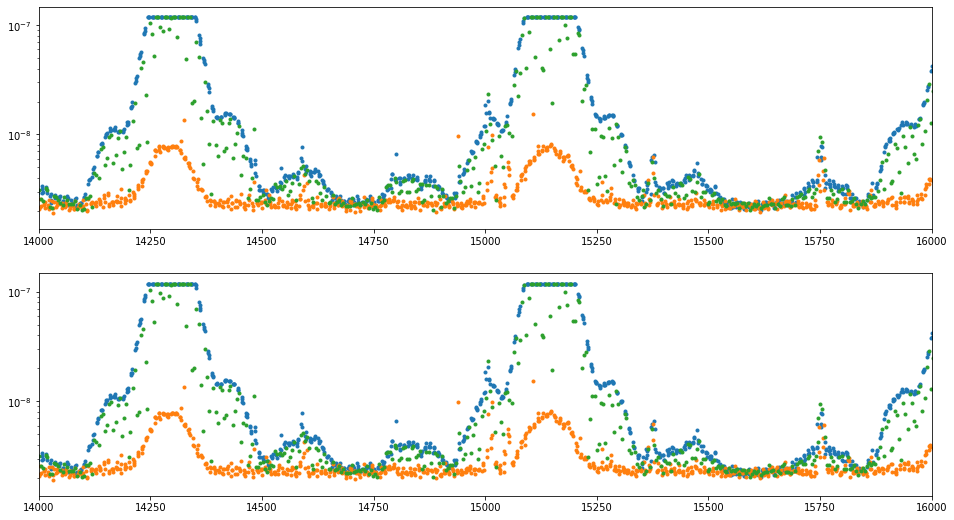

In [113]:
fig1,[ax1,ax2]=subplots(nrows=2,ncols=1,figsize=(16,9))
#semilogy(pulsedgridconcat.t_index,pulsedgridconcat.V[:,900,0],'.')
ax1.semilogy(pulsedgridconcat.inds_on,pulsedgridconcat.V[pulsedgridconcat.inds_on,900,0],'.')
ax1.semilogy(pulsedgridconcat.inds_off,pulsedgridconcat.V[pulsedgridconcat.inds_off,900,0],'.')
ax1.semilogy(pulsedgridconcat.inds_span,pulsedgridconcat.V[pulsedgridconcat.inds_span,900,0],'.')

ax2.semilogy(inds_on,pulsedgridconcat.V[inds_on,900,0],'.')
ax2.semilogy(inds_off,pulsedgridconcat.V[inds_off,900,0],'.')
ax2.semilogy(inds_span,pulsedgridconcat.V[inds_span,900,0],'.')
#ax2.semilogy(np.intersect1d(np.where(1.0>switch_interp_f),np.where(switch_interp_f>0.0)),pulsedgridconcat.V[np.intersect1d(np.where(1.0>switch_interp_f),np.where(switch_interp_f>0.0)),900,0],'kx')
#ax2.semilogy(np.array(np.where(np.diff(np.sign(switch_interp_f-0.5)))[0]).tolist(),pulsedgridconcat.V[np.array(np.where(np.diff(np.sign(switch_interp_f-0.5)))[0]).tolist(),900,0],'rx')
ax1.set_xlim(14000,16000)
ax2.set_xlim(14000,16000)

In [108]:
np.where(np.diff([0,0,0,0,0,0,0,1])==1)[0][0]+1

7

In [1352]:
## Wednesday RFI Flight

## Read Drone Data: drone_directory=u'/Users/wct9/Desktop/GBO/'
ndishes=4
fly508drn=Drone_Data(dronedir=drone_directory,\
                FLYTAG='FLY508.csv',\
                Origin_llh=GBO_HIRAX_DISH_0,\
                Origin_key='Hirax_Dish_0',\
                dkeys=Array_Keys[:ndishes],\
                dcoords=Array_Coords[:ndishes],\
                dpointings=Array_Pointings[:ndishes],\
                dpols=Array_Pols[:ndishes])

## 4 DISH PLOTTING:
GBO_chmap=np.array([0,1,3,2,4,5,7,6])
GBO_automap=np.array([ 0,  8, 21, 15, 26, 30, 35, 33])
#GBO_automap=np.zeros(len(GBO_chmap)).astype(int)
#prodmat=np.array([element for tupl in test1.prod for element in tupl]).reshape(len(test1.prod),2)
#for i,j in enumerate(GBO_chmap):
#    GBO_automap[i]=np.intersect1d(np.where(prodmat[:,0]==j),np.where(prodmat[:,1]==j))
    
gaindir='/Users/wct9/Desktop/GBO/20210825T185917Z_yale_drone_yale_digitalgain/'
datadir='/Users/wct9/Desktop/GBO/20210825T185917Z_yale_drone/corr/20210825T185959Z/'
fly508corr=Corr_Data(Data_Directory=datadir,visindex=np.sort(GBO_automap),Gain_Directory=gaindir)

fly508concat=CONCAT(CORRDATCLASS=fly508corr,DRONEDATCLASS=fly508drn)

Initializing drone data via datcon_csv routine: FLY508.csv
Interpolating time starting at 2021-08-25T18:52:34Z
generating llh, geocentric cartesian, local cartesian, and local spherical coordinates.
generating dish and receiver line of sight coordinates.


TypeError: __init__() got an unexpected keyword argument 'visindex'

In [ ]:
semilogy(fly508concat.V[8900:9400,900,2],'.')

In [ ]:
semilogy(np.nanmean(fly508concat.V[2500:5000,:,2],axis=0),'.')
semilogy(np.nanmean(fly508concat.V[9000:9100,:,2],axis=0),'.')
#semilogy(fly508concat.V[1000,:,0],'.')

In [ ]:
fly508corr.freq[256]

In [ ]:
fly508corr.Plot_Auto_Corr_Waterfalls_4dish(chmap=GBO_chmap,prodmap=[0,1,3,2,4,5,7,6])

In [ ]:
fly508corr.Plot_Auto_Corr_Time_Series_4dish(chmap=GBO_chmap,prodmap=[0,1,3,2,4,5,7,6])

In [ ]:
10000/256

In [ ]:
fd=h5py.File(fly508corr.Data_Directory+fly508corr.filenames[0], 'r')
fd1=h5py.File(fly508corr.Data_Directory+fly508corr.filenames[39], 'r')
vis=fd['vis'][:]
vis1=fd1['vis'][:]

fig1,ax1=subplots(nrows=1,ncols=1,figsize=(9,9))
for i,key in enumerate(GBO_automap):
    ax1.plot(np.nanmax(vis[:,:,key].real,axis=0),'.',c=colorsarr[i],label='{}'.format(key))
    ax1.plot(np.nanmax(vis1[:,:,key].real,axis=0),'.',c=colorsarr[i],label='{}'.format(key))
ax1.legend()

In [ ]:
## First Wednesday Flight, looking at signal levels with dependence on yaw


## Read Drone Data: drone_directory=u'/Users/wct9/Desktop/GBO/'
ndishes=4
fly500drn=Drone_Data(dronedir=drone_directory,\
                FLYTAG='FLY500.csv',\
                Origin_llh=GBO_HIRAX_DISH_0,\
                Origin_key='Hirax_Dish_0',\
                dkeys=Array_Keys[:ndishes],\
                dcoords=Array_Coords[:ndishes],\
                dpointings=Array_Pointings[:ndishes],\
                dpols=Array_Pols[:ndishes])

## 4 DISH PLOTTING:
GBO_chmap=np.array([0,1,3,2,4,5,7,6])
GBO_automap=np.array([ 0,  8, 21, 15, 26, 30, 35, 33])
#GBO_automap=np.zeros(len(GBO_chmap)).astype(int)
#prodmat=np.array([element for tupl in test1.prod for element in tupl]).reshape(len(test1.prod),2)
#for i,j in enumerate(GBO_chmap):
#    GBO_automap[i]=np.intersect1d(np.where(prodmat[:,0]==j),np.where(prodmat[:,1]==j))
    
gaindir='/Users/wct9/Desktop/GBO/20210825T134238Z_yale_drone_yale_digitalgain/'
datadir='/Users/wct9/Desktop/GBO/20210825T134238Z_yale_drone/corr/20210825T134320Z/'
fly500corr=Corr_Data(Data_Directory=datadir,visindex=np.sort(GBO_automap),Gain_Directory=gaindir)

fly500concat=CONCAT(CORRDATCLASS=fly500corr,DRONEDATCLASS=fly500drn)

In [ ]:
fly500corr.Plot_Auto_Corr_Time_Series_4dish(chmap=GBO_chmap,prodmap=[0,1,3,2,4,5,7,6],tbounds=[10000,-1],freqlist=[100,900])

In [ ]:
fig1,[ax1,ax2]=subplots(nrows=2,ncols=1,figsize=(16,6),sharex=True)

#plot(fly500concat.t_arr_datetime,fly500concat.V[:,900,0],'.')
#plot(fly500concat.t_arr_datetime[slb:sub],fly500concat.V[slb:sub,900,0],'.')
#plot(fly500concat.drone_yaw_interp[slb:sub])
ax1.plot(fly500concat.t_arr_datetime[:26000],fly500concat.V[:26000,820,4],'.',label=str(key))
ax1.plot(fly500concat.t_arr_datetime[slb:sub],fly500concat.V[slb:sub,820,4],'.',label=str(key))
ax1.plot(fly500concat.t_arr_datetime[20000:25000],fly500concat.V[20000:25000,820,4],'.',label=str(key))
ax1.plot(fly500concat.t_arr_datetime[17000:18000],fly500concat.V[17000:18000,820,4],'.',label=str(key))

ax2.plot(fly500concat.t_arr_datetime[:],fly500concat.drone_xyz_LC_interp[:,2])


In [ ]:
slb,sub=[10000,11500]
axvline(5)
axvline(95)
axvline(185)
axvline(275)
for key in [0,1]:
    plot(fly500concat.drone_yaw_interp[slb:sub],fly500concat.V[slb:sub,900,key]/np.nanmax(fly500concat.V[slb:sub,900,key]),'.',label=str(key))
legend()

In [ ]:
Test_Grid_Concat=CONCAT(CORRDATCLASS=test1,DRONEDATCLASS=dronedattest)

In [ ]:
dronedattest.Plot_Transmitter_Pointing()

In [ ]:
flo,fhi=[900,910]
Test_Grid_Concat.Plot_Beammap_LC(f_bounds=[flo,fhi],t_bounds=[4000,20000],chanmap=[0,1])
Test_Grid_Concat.Plot_Beammap_LC(f_bounds=[flo,fhi],t_bounds=[4000,20000],chanmap=[2,3])
Test_Grid_Concat.Plot_Beammap_LC(f_bounds=[flo,fhi],t_bounds=[4000,20000],chanmap=[4,5])
Test_Grid_Concat.Plot_Beammap_LC(f_bounds=[flo,fhi],t_bounds=[4000,20000],chanmap=[6,7])

In [ ]:
interplb,interpub=[4000,20000] # Full Grid
#interplb,interpub=[7340,20570] # Full Grid
#interplb,interpub=[7340,13930] # East-West Grid Time Indices
#interplb,interpub=[13930,20570] # North-South Grid Time Indices
interplb,interpub=[9850,10400] # Full Grid
fig2,[ax1,ax2,ax3]=subplots(nrows=1,ncols=3,figsize=(16,6))
for i,ax in enumerate([ax1,ax2]):
    #ax.semilogy(Test_Grid_Concat.t_index[interplb:interpub],Test_Grid_Concat.V[interplb:interpub,250,i],'.')
    ax.semilogy(Test_Grid_Concat.t_index[interplb:interpub],Test_Grid_Concat.V[interplb:interpub,900,i],'.')
    ax.set_xlabel('Time Index')
    ax.set_ylabel('Power $[ADU^2]$')
ax3.plot(Test_Grid_Concat.drone_xyz_LC_interp[interplb:interpub,0],Test_Grid_Concat.drone_xyz_LC_interp[interplb:interpub,1],'.')
interplb,interpub=[9850,10280] # Full Grid
ax3.plot(Test_Grid_Concat.drone_xyz_LC_interp[interplb:interpub,0],Test_Grid_Concat.drone_xyz_LC_interp[interplb:interpub,1],'.')


In [ ]:
plot(dronedattest.t_arr_datetime)
plot(test1.t_arr_datetime)

In [ ]:
fig,ax1=subplots(nrows=1,ncols=1,figsize=(9,9))

for i,key in enumerate(Array_Keys):
    plot(Array_Coords[i,0],Array_Coords[i,1],'x',label=key)
legend()

ax1.set_xlim(-30,10)
ax1.set_ylim(-20,20)

In [ ]:
## 4 DISH PLOTTING:
GBO_chmap=np.array([0,1,3,2,4,5,7,6])
GBO_automap=np.array([ 0,  8, 21, 15, 26, 30, 35, 33])
skip
GBO_automap=np.zeros(len(GBO_chmap)).astype(int)
prodmat=np.array([element for tupl in test1.prod for element in tupl]).reshape(len(test1.prod),2)
for i,j in enumerate(GBO_chmap):
    GBO_automap[i]=np.intersect1d(np.where(prodmat[:,0]==j),np.where(prodmat[:,1]==j))

In [ ]:
gaindir='/Users/wct9/Desktop/GBO/20210824T205320Z_yale_drone_yale_digitalgain/'
datadir='/Users/wct9/Desktop/GBO/20210824T205320Z_yale_drone/corr/20210824T205331Z/'

test1=Corr_Data(Data_Directory=datadir,visindex=np.sort(GBO_automap),Gain_Directory=gaindir)

In [ ]:
test1.Plot_Auto_Corr_Waterfalls_4dish(chmap=GBO_chmap,prodmap=[0,1,3,2,4,5,7,6])

In [ ]:
fig1,ax1=subplots(nrows=1,ncols=1,figsize=(9,9))
im=ax1.imshow(test1.V_full[:,:,0],aspect="auto",cmap='gnuplot2',norm=LogNorm())
divider=make_axes_locatable(ax1)
cax=divider.append_axes("right", size="5%", pad=0.05)
cbar=fig1.colorbar(im,cax=cax)
ax1.axvline(308,c='r')

In [ ]:
fig1,ax1=subplots(nrows=1,ncols=1,figsize=(9,9))
for i in np.arange(25,200,13):
    ax1.plot(test1.V_full[:,i,0],'.',label="{}: {}".format(i,test1.freq[i]))
ax1.legend()

In [ ]:
test1.Plot_Auto_Corr_Time_Series_4dish(chmap=GBO_chmap,prodmap=[0,1,3,2,4,5,7,6],tbounds=[0,-1],freqlist=[170,700,805,900])

In [ ]:
test1.Plot_Auto_Corr_Spectra_4dish(chmap=GBO_chmap,prodmap=[0,1,3,2,4,5,7,6],tbounds=[5,-5],tstep=2000)

In [ ]:
test1.Plot_Gains_vs_Data_4dish(chmap=GBO_chmap,prodmap=[0,1,3,2,4,5,7,6])

In [ ]:
fd=h5py.File(test1.Data_Directory+test1.filenames[0], 'r')
fd1=h5py.File(test1.Data_Directory+test1.filenames[42], 'r')
vis=fd['vis'][:]
vis1=fd1['vis'][:]

fig1,ax1=subplots(nrows=1,ncols=1,figsize=(9,9))
for i,key in enumerate(GBO_automap):
    ax1.plot(np.nanmax(vis[:,:,key].real,axis=0),'.',c=colorsarr[i],label='{}'.format(key))
    ax1.plot(np.nanmax(vis1[:,:,key].real,axis=0),'.',c=colorsarr[i],label='{}'.format(key))
ax1.legend()

In [ ]:
fd=h5py.File(test1.Data_Directory+test1.filenames[0], 'r')
fd1=h5py.File(test1.Data_Directory+test1.filenames[49], 'r')
vis=fd['vis'][:]
vis1=fd1['vis'][:]

fig1,ax1=subplots(nrows=1,ncols=1,figsize=(9,9))
for i,key in enumerate(GBO_automap):
    ax1.plot(np.nanmax(vis[:,:,key].real,axis=0),'.',c=colorsarr[i],label='{}'.format(key))
    ax1.plot(np.nanmax(vis1[:,:,key].real,axis=0),'.',c=colorsarr[i],label='{}'.format(key))
ax1.legend()

In [ ]:
fd=h5py.File(test1.Data_Directory+test1.filenames[0], 'r')
fd1=h5py.File(test1.Data_Directory+test1.filenames[40], 'r')
vis=fd['vis'][:]
vis1=fd1['vis'][:]

fig1,ax1=subplots(nrows=1,ncols=1,figsize=(9,9))
for i,key in enumerate(GBO_automap):
    ax1.plot(np.nanmax(vis[:,:,key].real,axis=0),'.',c=colorsarr[i],label='{}'.format(key))
    ax1.plot(np.nanmax(vis1[:,:,key].real,axis=0),'.',c=colorsarr[i],label='{}'.format(key))
ax1.legend()

In [ ]:
drone_directory=u'/Users/wct9/Desktop/GBO/'
ndishes=4
spintest=Drone_Data(dronedir=drone_directory,\
                FLYTAG='FLY496.csv',\
                Origin_llh=GBO_HIRAX_DISH_0,\
                Origin_key='Hirax_Dish_0',\
                dkeys=Array_Keys[:ndishes],\
                dcoords=Array_Coords[:ndishes],\
                dpointings=Array_Pointings[:ndishes],\
                dpols=Array_Pols[:ndishes])

In [ ]:
gaindir='/Users/wct9/Desktop/GBO/20210824T201532Z_yale_drone_yale_digitalgain/'
datadir='/Users/wct9/Desktop/GBO/20210824T201532Z_yale_drone/corr/20210824T201543Z/'
## 2 DISH PLOTTING:
GBO_chmap=np.array([0,1])
GBO_automap=np.zeros(len(GBO_chmap)).astype(int)
prodmat=np.array([element for tupl in test1.prod for element in tupl]).reshape(len(test1.prod),2)
for i,j in enumerate(GBO_chmap):
    GBO_automap[i]=np.intersect1d(np.where(prodmat[:,0]==j),np.where(prodmat[:,1]==j))
spindat=Corr_Data(Data_Directory=datadir,Gain_Directory=gaindir)

In [ ]:
plot(spintest.t_arr_datetime)
plot(spindat.t_arr_datetime)
spin_Concat=CONCAT(CORRDATCLASS=spindat,DRONEDATCLASS=spintest)

In [ ]:
slb,sub=[23000,26000]
axvline(20)
axvline(105)
axvline(210)
axvline(300)
plot(spin_Concat.drone_yaw_interp[slb:sub],spin_Concat.V[slb:sub,900,0]/np.nanmax(spin_Concat.V[slb:sub,900,0]),'.')
plot(spin_Concat.drone_yaw_interp[slb:sub],spin_Concat.V[slb:sub,900,2]/np.nanmax(spin_Concat.V[slb:sub,900,2]),'.')